In [402]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib notebook

In [403]:
def mean_squared_error(y_true, y_pred, squared=True):
    t = np.sum((y_true - y_pred) ** 2) / y_true.shape[0]
    if squared:
        return t
    return np.sqrt(t)

def train_test_split(data, label, validation_size=None, test_size=None):
    if not validation_size:
        validation_size = 0.2
    if not test_size:
        test_size = 0.2
    size = data.shape[0]
    # ratio ?
    if validation_size < 1:
        validation_size = int(validation_size * size)
    if test_size < 1:
        test_size = int(test_size * size)
    # shuffle data
    random_indices = np.arange(size)
    np.random.shuffle(random_indices)
    data = data[random_indices]
    label = label[random_indices]
    # split data
    X_train, X_val, X_test = data[validation_size+test_size:], data[test_size: test_size+validation_size], data[:test_size]
    y_train, y_val, y_test= label[validation_size+test_size:], label[test_size: test_size+validation_size], label[:test_size]
    return X_train, X_val, X_test, y_train, y_val, y_test

# one hot encoder
def E(x, classes):
    return np.eye(classes)[x]

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def d_sigmoid(x):
    t = sigmoid(x)
    return t * (1 - t)

def identity(x):
    return x

def d_identity(x):
    return x / x

def softmax(x):
    tmp = np.exp(x)
    return tmp / np.sum(tmp, axis=0)

def relu(x):
    return x * (x > 0)

def d_relu(x):
    return 1 * (x > 0)

def contourplot(X_test, y_test, model, t, title):
    h = .02  # step size in the mesh
    x_min, x_max = X_test[:, 0].min() - 1, X_test[:, 0].max() + 1
    y_min, y_max = X_test[:, 1].min() - 1, X_test[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    Z = t(model(np.c_[xx.ravel(), yy.ravel()].T))
    Z = Z.reshape(xx.shape)
    plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.8)
    plt.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=plt.cm.coolwarm, edgecolor='black')
    plt.xlabel('1st component')
    plt.ylabel('2nd component')
    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.title(title)
    plt.show()
    
def confusion_matrix(y_true, y_pred):
    nclasses = np.unique(y_true).shape[0]
    c = np.zeros((nclasses, nclasses))
    for i in range(nclasses):     # i -> actual
        for j in range(nclasses): # j -> prediction
            c[i][j] = np.sum(y_pred[y_true == i] == j)
    return c

In [404]:
class Sequential():
    def __init__(self, *layers, loss=None):
        self.prev_layer_size = None
        self.layers = []
        self.L = 0
        self.loss = loss
        if layers:
            for layer in layers:
                self.add(layer)
            
    def __call__(self, X):
        return self.forward_propagation(X)
                
    def add(self, layer):
        if isinstance(layer, Input):
            self.layers.append(layer)
            self.prev_layer_size = layer.n_inputs
        elif isinstance(layer, Dense):
            self.layers.append(layer)
            if not self.prev_layer_size:
                raise Exception("Input size not provided")
            layer.W = np.random.normal(scale=1/np.sqrt(self.prev_layer_size), size=(layer.units, self.prev_layer_size))
            layer.B = np.zeros((layer.units,))
            self.L += 1
            self.prev_layer_size = layer.units
        else:
            raise TypeError("Invalid layer")
            
    def forward_propagation(self, X):
        for layer in self.layers:
            X = layer(X)
        return X
    
    def back_propagation(self, Y, batch_size):
        self.layers[-1].grad_L_A = self.loss.grad(Y, self.layers[-1].H, self.layers[-1].A)
        for i in range(len(self.layers) - 1, 0, -1):
            if not isinstance(self.layers[i], Input):
                self.layers[i].grad_L_W = (1 / batch_size) * (self.layers[i].grad_L_A @ self.layers[i-1].H.T)
                self.layers[i].grad_L_B = (1 / batch_size) * np.sum(self.layers[i].grad_L_A, axis=1)
            if not isinstance(self.layers[i-1], Input):
                self.layers[i-1].grad_L_H = self.layers[i].W.T @ self.layers[i].grad_L_A
                self.layers[i-1].grad_L_A = self.layers[i-1].grad_L_H * self.layers[i-1].d_activation(self.layers[i-1].A)
            # parameter update
            self.layers[i].W = self.layers[i].W - self.lr * self.layers[i].grad_L_W
            self.layers[i].B = self.layers[i].B - self.lr * self.layers[i].grad_L_B
    
    def fit(self, train_data, label, batch_size=32, lr=1, epochs=5):
        self.lr = lr
        self.batch_size = batch_size
        # make batches
        total_data = train_data.shape[1]
        nbatches = int(np.ceil(total_data/self.batch_size))
        self.losses = []
        for e in range(epochs):
            err = 0
            print(f"Epoch {e+1}\n-------------------------------")
            for i in range(nbatches):
                begin = i * self.batch_size
                end = min(begin + self.batch_size, total_data)
                X = train_data[:, begin:end]
                Y = label[:, begin:end]
                Y_pred = self.forward_propagation(X)
                self.back_propagation(Y, end-begin)
                err += self.loss(Y, Y_pred)
            self.losses.append(err/nbatches)
        print("Done!")
                    
class Input:
    def __init__(self, n_inputs):
        self.n_inputs = n_inputs
        self.H = None
        
    def __call__(self, X, **kwargs):
        self.H = X
        return self.H

class Dense:
    # TODO: make activation_fn_map and other activation functions static
    def __init__(self, units, activation):
        activation_fn_map = {
            "sigmoid": (sigmoid, d_sigmoid),
            "relu": (relu, d_relu),
            "linear": (identity, d_identity),
            "softmax": (softmax, None),
        }
        # TODO: add functionality for input_shape
        self.units = units
        self.H, self.A = None, None
        self.W, self.B = None, None
        self.grad_L_H, self.grad_L_A = None, None
        self.grad_L_W, self.grad_L_B = None, None
        self.activation, self.d_activation = activation_fn_map[activation]
    
    def __call__(self, X):
        self.A = self.W @ X + self.B.reshape(-1, 1)
#         self.A = np.clip(self.A, -709, 709)
        self.H = self.activation(self.A)
        return self.H    
        
class CrossEntropyLoss:
    def __init__(self, activation):
        self.activation = activation
    
    def __call__(self, y_true, y_pred):
        t = np.argmax(y_true, axis=0)
        return -np.log(y_pred[t, np.arange(t.shape[0])]).mean()
        
    def grad(self, y_true, y_pred, *args, **kwargs):
        if self.activation == 'softmax':
            return y_pred - y_true
        else:
            raise Exception('Not implemented')
    
class MeanSquaredLoss:
    def __init__(self, activation):
        self.activation = activation
    
    def __call__(self, y_true, y_pred):
        return np.mean((y_pred - y_true) ** 2)
        
    def grad(self, y_true, y_pred, A):
        if self.activation == 'sigmoid':
            return (y_pred - y_true) * d_sigmoid(A)
        elif self.activation == 'linear':
            return y_pred - y_true
        elif self.activation == 'relu':
            return (y_pred - y_true) * d_relu(A)
        else:
            raise Exception('Not implemented')

# Perceptron

In [62]:
df1 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Classification/LS_Group08/Class1.txt', sep=' ', header=None)
df2 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Classification/LS_Group08/Class2.txt', sep=' ', header=None)
df3 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Classification/LS_Group08/Class3.txt', sep=' ', header=None)
df1['class'] = 0
df2['class'] = 1
df3['class'] = 2

In [63]:
data = pd.concat((df1, df2, df3))
label = data.pop('class')

In [64]:
data_0_1 = data[(label == 0) | (label == 1)]
label_0_1 = label[(label == 0) | (label == 1)] == 1
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data_0_1.values, label_0_1.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [65]:
model1 = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [66]:
model1.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [67]:
predictions = model1(X_val)
print(f'Validation accuracy = {np.sum((predictions > 0.5) == y_val) * 100 / predictions.shape[1]}%')

Validation accuracy = 100.0%


In [68]:
predictions = model1(X_test)
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_test) * 100 / predictions.shape[1]}%')

Test accuracy = 100.0%


<IPython.core.display.Javascript object>


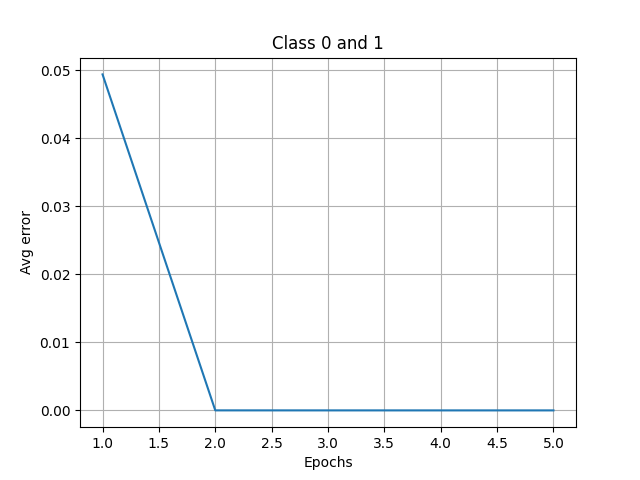

In [95]:
plt.grid(True)
plt.title('Class 0 and 1')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model1.losses)+1), model1.losses)

<IPython.core.display.Javascript object>


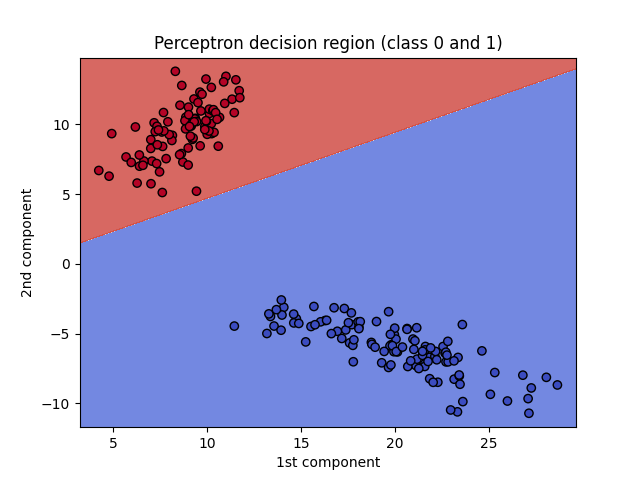

In [70]:
contourplot(X_test.T, y_test.flatten(), model1, lambda x: x > 0.5, 'Perceptron decision region (class 0 and 1)')

In [71]:
confusion_matrix(y_test.flatten(), predictions.flatten() > 0.5)

array([[111.,   0.],
       [  0.,  89.]])

In [87]:
data_0_2 = data[(label == 0) | (label == 2)]
label_0_2 = label[(label == 0) | (label == 2)] == 2
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data_0_2.values, label_0_2.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [91]:
model2 = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [92]:
model2.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [93]:
predictions = model2(X_val)
print(f'Validation accuracy = {np.sum((predictions > 0.5) == y_val) * 100 / predictions.shape[1]}%')

Validation accuracy = 100.0%


In [94]:
predictions = model2(X_test)
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_test) * 100 / predictions.shape[1]}%')

Test accuracy = 100.0%


<IPython.core.display.Javascript object>


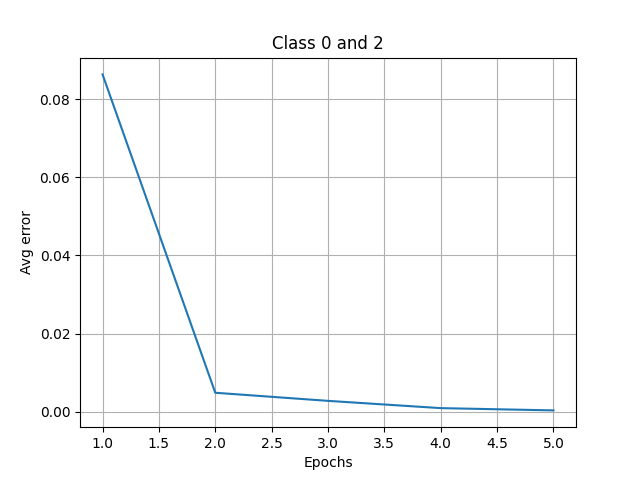

In [49]:
plt.grid(True)
plt.title('Class 0 and 2')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model2.losses)+1), model2.losses)

<IPython.core.display.Javascript object>


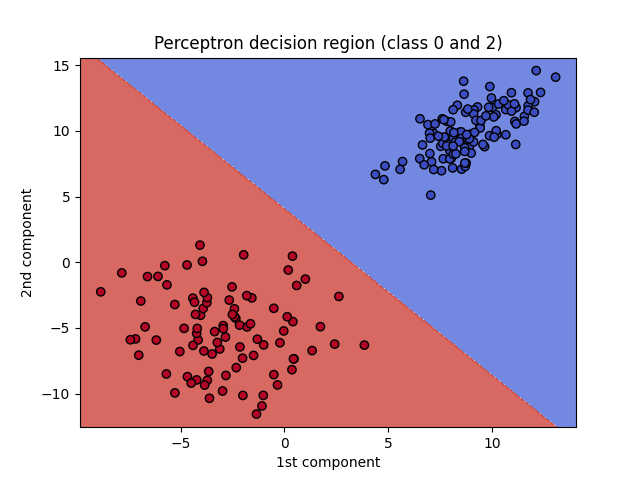

In [105]:
contourplot(X_test.T, y_test.flatten(), model2, lambda x: x > 0.5, 'Perceptron decision region (class 0 and 2)')

In [51]:
confusion_matrix(y_test.flatten(), predictions.flatten() > 0.5)

array([[111.,   0.],
       [  0.,  89.]])

In [96]:
data_1_2 = data[(label == 1) | (label == 2)]
label_1_2 = label[(label == 1) | (label == 2)] == 2
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data_1_2.values, label_1_2.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [97]:
model3 = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [98]:
model3.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [99]:
predictions = model3(X_val)
print(f'Validation accuracy = {np.sum((predictions > 0.5) == y_val) * 100 / predictions.shape[1]}%')

Validation accuracy = 100.0%


In [100]:
predictions = model3(X_test)
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_test) * 100 / predictions.shape[1]}%')

Test accuracy = 100.0%


<IPython.core.display.Javascript object>


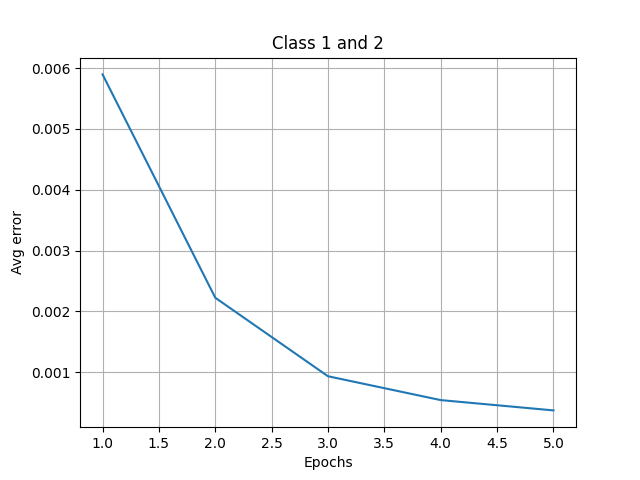

In [101]:
plt.grid(True)
plt.title('Class 1 and 2')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model3.losses)+1), model3.losses)

<IPython.core.display.Javascript object>


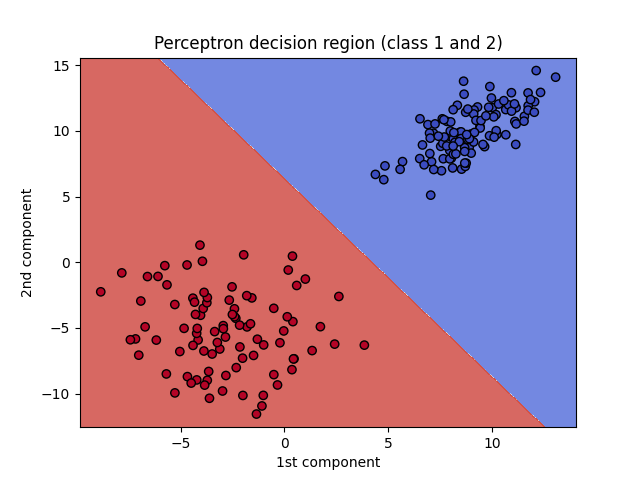

In [106]:
contourplot(X_test.T, y_test.flatten(), model3, lambda x: x > 0.5, 'Perceptron decision region (class 1 and 2)')

In [107]:
confusion_matrix(y_test.flatten(), predictions.flatten() > 0.5)

array([[110.,   0.],
       [  0.,  90.]])

In [130]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data.values, label.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [131]:
model = lambda X_test : (E(((model1(X_test) > 0.5) * 1).flatten(), 3) +  E(((model2(X_test) > 0.5) *2).flatten(), 3) + E(((model3(X_test) > 0.5) + 1).flatten(), 3)).argmax(axis=1)
y_test = model(X_test)

<IPython.core.display.Javascript object>


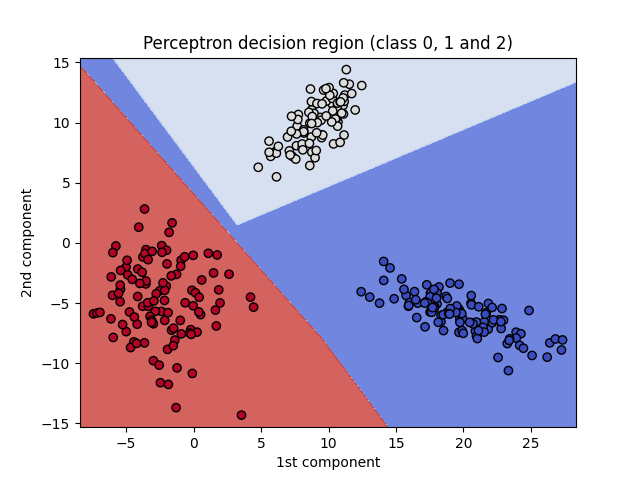

In [132]:
contourplot(X_test.T, y_test, model, lambda x: x, 'Perceptron decision region (class 0, 1 and 2)')

# FCNN

In [133]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data.values, label.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = E(y_train, 3).T
y_val = E(y_val, 3).T
y_test = E(y_test, 3).T

In [137]:
model = Sequential(
    Input(n_inputs=2),
    Dense(5, activation='sigmoid'),
    Dense(3, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [138]:
model.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [139]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum(predictions.argmax(axis=0) == y_val.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Validation Accuracy = 100.0%


In [140]:
predictions = model(X_test)
print(f'Test Accuracy = {np.sum(predictions.argmax(axis=0) == y_test.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Test Accuracy = 100.0%


<IPython.core.display.Javascript object>


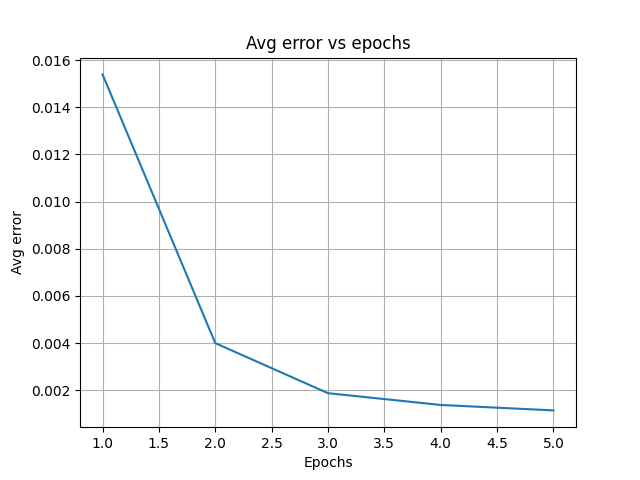

In [141]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


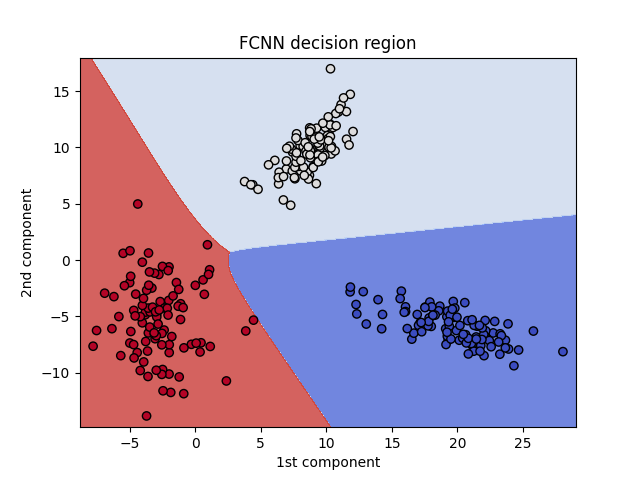

In [142]:
contourplot(X_test.T, y_test.argmax(axis=0), model, lambda x: x.argmax(axis=0), 'FCNN decision region')

In [143]:
confusion_matrix(y_test.argmax(axis=0), predictions.argmax(axis=0))

array([[ 98.,   0.,   0.],
       [  0., 102.,   0.],
       [  0.,   0., 100.]])

In [159]:
model = Sequential(
    Input(n_inputs=2),
    Dense(10, activation='sigmoid'),
    Dense(3, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [160]:
model.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [161]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum(predictions.argmax(axis=0) == y_val.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Validation Accuracy = 100.0%


In [162]:
predictions = model(X_test)
print(f'Test Accuracy = {np.sum(predictions.argmax(axis=0) == y_test.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Test Accuracy = 100.0%


<IPython.core.display.Javascript object>


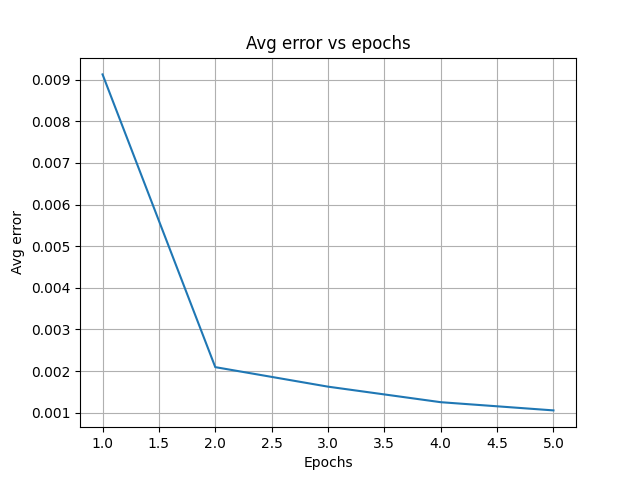

In [163]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


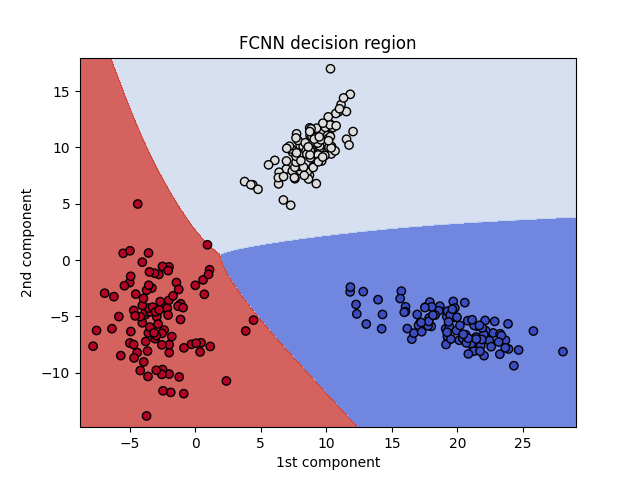

In [164]:
contourplot(X_test.T, y_test.argmax(axis=0), model, lambda x: x.argmax(axis=0), 'FCNN decision region')

In [165]:
confusion_matrix(y_test.argmax(axis=0), predictions.argmax(axis=0))

array([[ 98.,   0.,   0.],
       [  0., 102.,   0.],
       [  0.,   0., 100.]])

In [166]:
model = Sequential(
    Input(n_inputs=2),
    Dense(15, activation='sigmoid'),
    Dense(3, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [167]:
model.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [168]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum(predictions.argmax(axis=0) == y_val.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Validation Accuracy = 100.0%


In [169]:
predictions = model(X_test)
print(f'Test Accuracy = {np.sum(predictions.argmax(axis=0) == y_test.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Test Accuracy = 100.0%


<IPython.core.display.Javascript object>


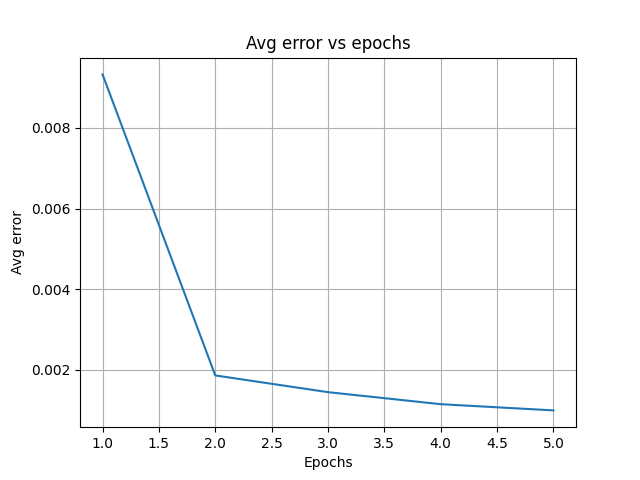

In [170]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


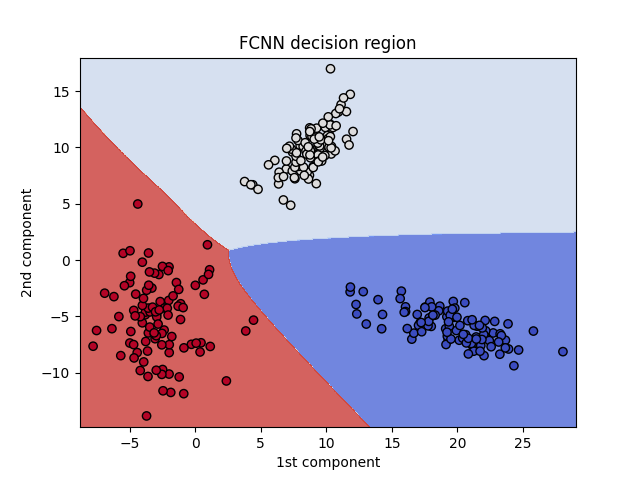

In [171]:
contourplot(X_test.T, y_test.argmax(axis=0), model, lambda x: x.argmax(axis=0), 'FCNN decision region')

In [174]:
confusion_matrix(y_test.argmax(axis=0), predictions.argmax(axis=0))

array([[ 98.,   0.,   0.],
       [  0., 102.,   0.],
       [  0.,   0., 100.]])

<IPython.core.display.Javascript object>


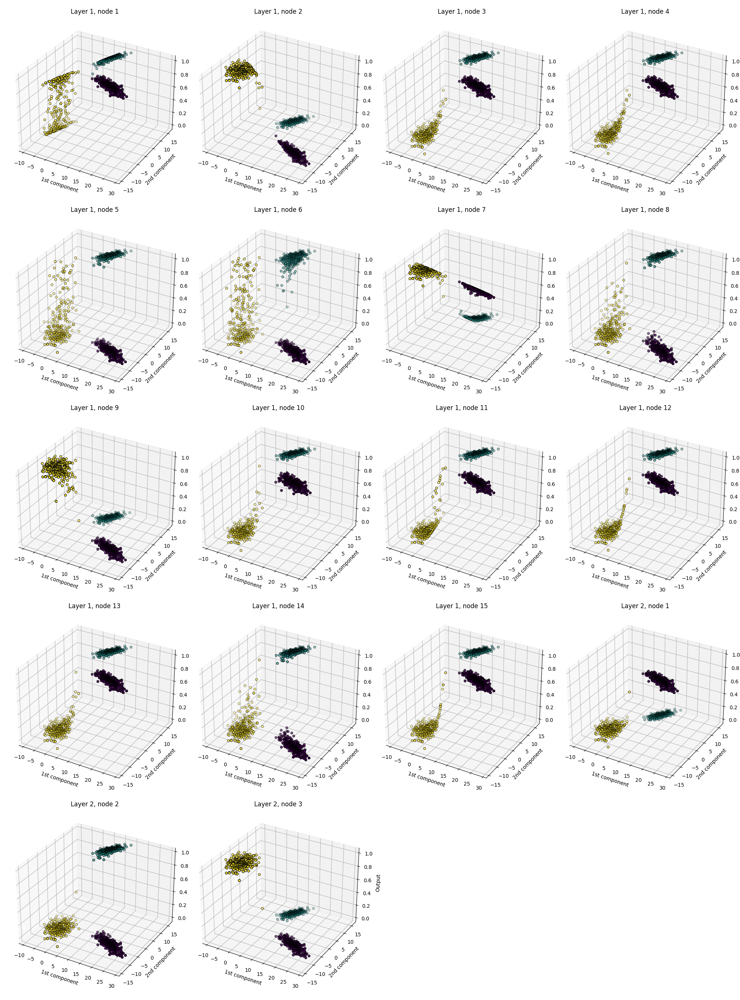

In [175]:
model(X_train)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_train, h, c=y_train.argmax(axis=0), edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


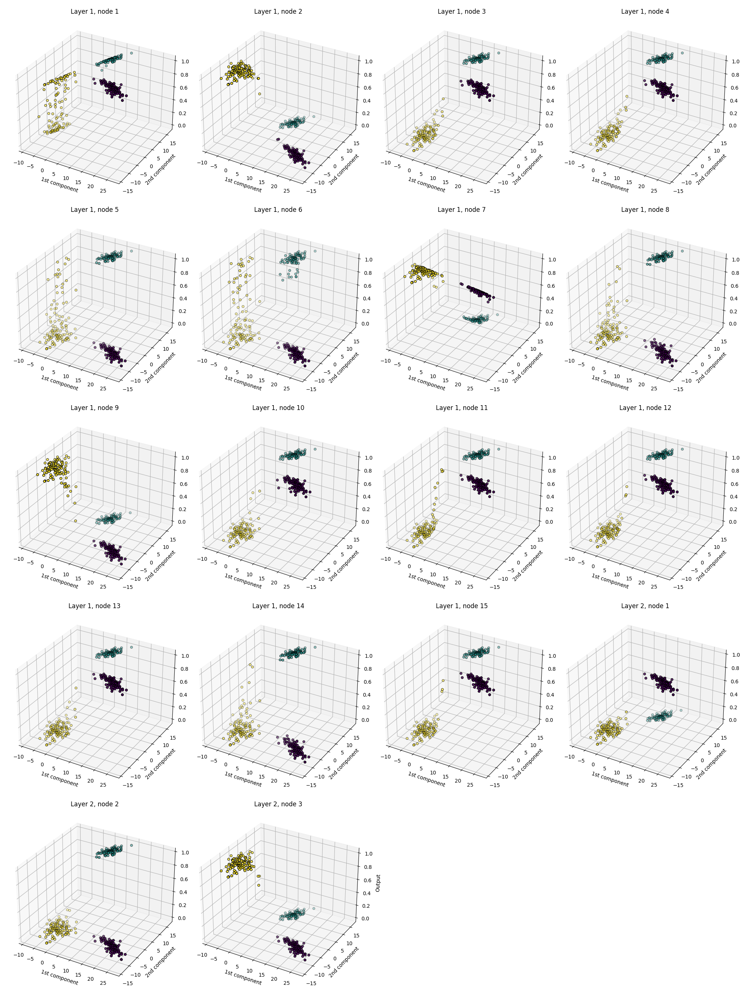

In [176]:
model(X_val)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_val, h, c=y_val.argmax(axis=0), edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


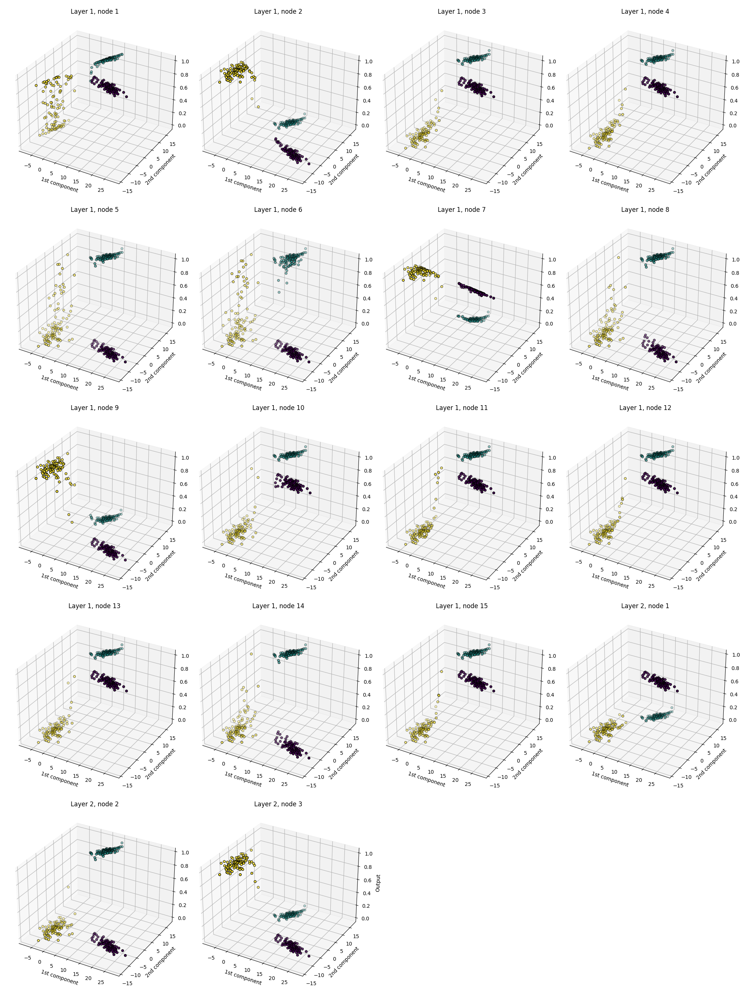

In [177]:
model(X_test)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_test, h, c=y_test.argmax(axis=0), edgecolor='black')
        itr += 1
fig.tight_layout()

# Non linear data

In [592]:
data = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Classification/NLS_Group08.txt', skiprows=1, header=None, sep=' ').drop(2, axis=1)

In [593]:
data.loc[:500, 'class'] = 0
data.loc[500:1000, 'class'] = 1
data.loc[1000:, 'class'] = 2
label = data.pop('class').astype(int)

In [594]:
data_0_1 = data[(label == 0) | (label == 1)]
label_0_1 = label[(label == 0) | (label == 1)] == 1
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data_0_1.values, label_0_1.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [595]:
model1 = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [596]:
model1.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [597]:
predictions = model1(X_val)
print(f'Validation accuracy = {np.sum((predictions > 0.5) == y_val) * 100 / predictions.shape[1]}%')

Validation accuracy = 94.0%


In [598]:
predictions = model1(X_test)
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_test) * 100 / predictions.shape[1]}%')

Test accuracy = 95.0%


<IPython.core.display.Javascript object>


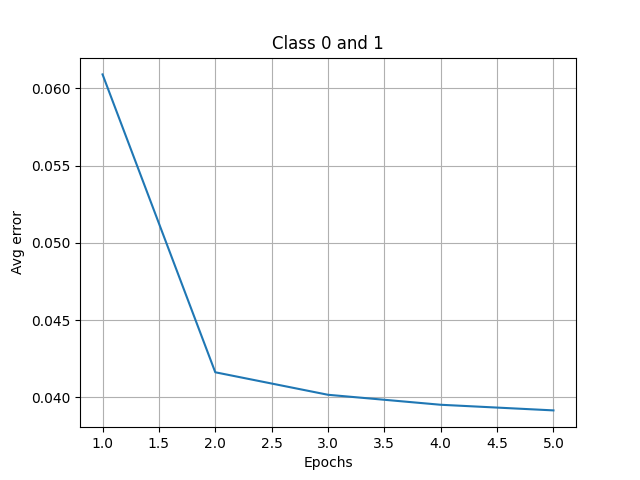

In [599]:
plt.grid(True)
plt.title('Class 0 and 1')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model1.losses)+1), model1.losses)

<IPython.core.display.Javascript object>


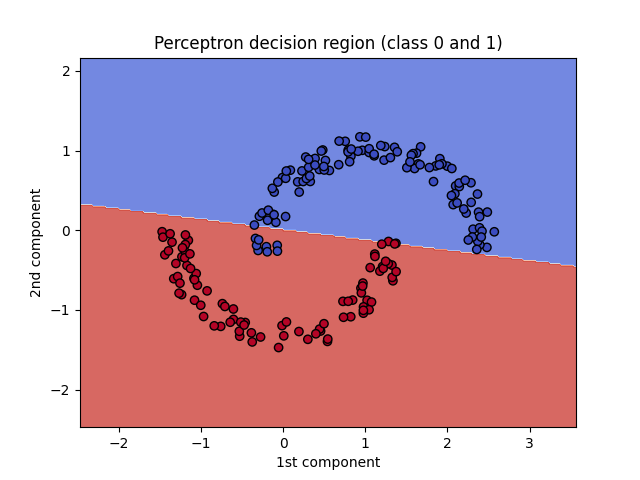

In [600]:
contourplot(X_test.T, y_test.flatten(), model1, lambda x: x > 0.5, 'Perceptron decision region (class 0 and 1)')

In [601]:
confusion_matrix(y_test.flatten(), predictions.flatten() > 0.5)

array([[104.,   8.],
       [  2.,  86.]])

In [618]:
data_0_2 = data[(label == 0) | (label == 2)]
label_0_2 = label[(label == 0) | (label == 2)] == 2
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data_0_2.values, label_0_2.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [619]:
model2 = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [624]:
model2.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [625]:
predictions = model2(X_val)
print(f'Validation accuracy = {np.sum((predictions > 0.5) == y_val) * 100 / predictions.shape[1]}%')

Validation accuracy = 64.33333333333333%


In [626]:
predictions = model2(X_test)
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_test) * 100 / predictions.shape[1]}%')

Test accuracy = 65.66666666666667%


<IPython.core.display.Javascript object>


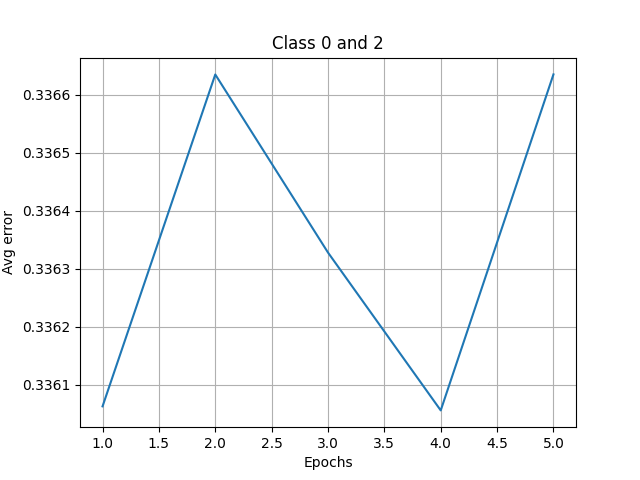

In [627]:
plt.grid(True)
plt.title('Class 0 and 2')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model2.losses)+1), model2.losses)

<IPython.core.display.Javascript object>


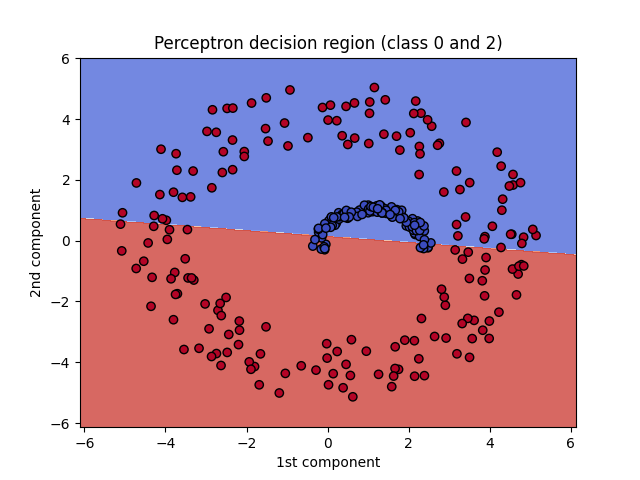

In [628]:
contourplot(X_test.T, y_test.flatten(), model2, lambda x: x > 0.5, 'Perceptron decision region (class 0 and 2)')

In [629]:
confusion_matrix(y_test.flatten(), predictions.flatten() > 0.5)

array([[98., 16.],
       [87., 99.]])

In [685]:
data_1_2 = data[(label == 1) | (label == 2)]
label_1_2 = label[(label == 1) | (label == 2)] == 2
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data_1_2.values, label_1_2.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [686]:
model3 = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [687]:
model3.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [688]:
predictions = model3(X_val)
print(f'Validation accuracy = {np.sum((predictions > 0.5) == y_val) * 100 / predictions.shape[1]}%')

Validation accuracy = 63.666666666666664%


In [689]:
predictions = model3(X_test)
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_test) * 100 / predictions.shape[1]}%')

Test accuracy = 68.33333333333333%


<IPython.core.display.Javascript object>


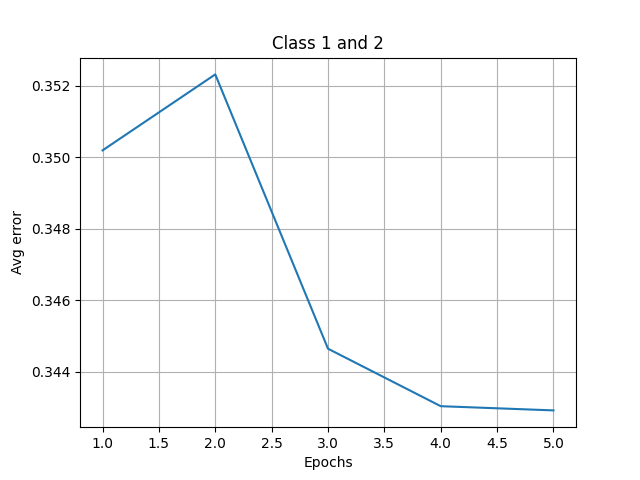

In [690]:
plt.grid(True)
plt.title('Class 1 and 2')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model3.losses)+1), model3.losses)

<IPython.core.display.Javascript object>


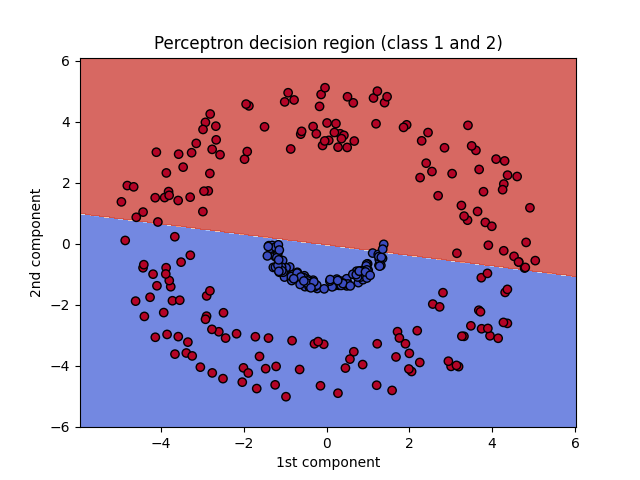

In [691]:
contourplot(X_test.T, y_test.flatten(), model3, lambda x: x > 0.5, 'Perceptron decision region (class 1 and 2)')

In [692]:
confusion_matrix(y_test.flatten(), predictions.flatten() > 0.5)

array([[103.,   2.],
       [ 93., 102.]])

In [693]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data.values, label.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [694]:
model = lambda X_test : (E(((model1(X_test) > 0.5) * 1).flatten(), 3) +  E(((model2(X_test) > 0.5) *2).flatten(), 3) + E(((model3(X_test) > 0.5) + 1).flatten(), 3)).argmax(axis=1)

In [695]:
print(f'Accuracy = {np.sum(y_test == model(X_test)) * 100 / y_test.size}%')

Accuracy = 44.0%


<IPython.core.display.Javascript object>


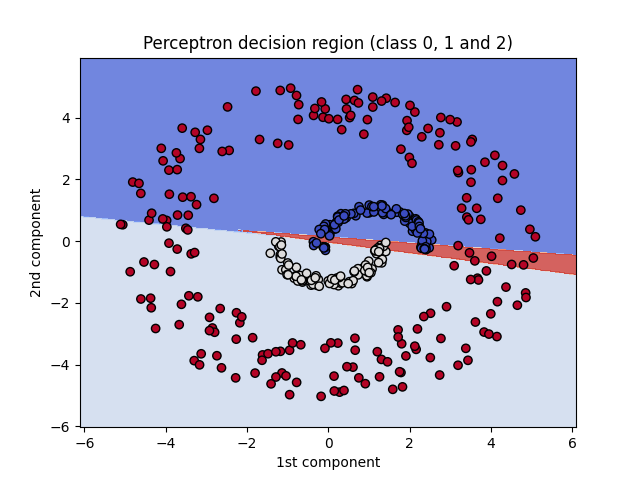

In [696]:
contourplot(X_test.T, y_test, model, lambda x: x, 'Perceptron decision region (class 0, 1 and 2)')

# FCNN

In [204]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data.values, label.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = E(y_train, 3).T
y_val = E(y_val, 3).T
y_test = E(y_test, 3).T

In [205]:
model = Sequential(
    Input(n_inputs=2),
    Dense(5, activation='sigmoid'),
    Dense(3, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [206]:
model.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [207]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum(predictions.argmax(axis=0) == y_val.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Validation Accuracy = 96.25%


In [208]:
predictions = model(X_test)
print(f'Test Accuracy = {np.sum(predictions.argmax(axis=0) == y_test.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Test Accuracy = 95.75%


<IPython.core.display.Javascript object>


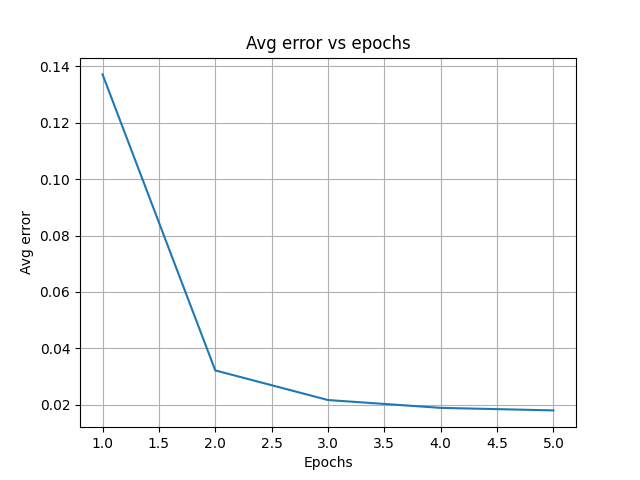

In [209]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


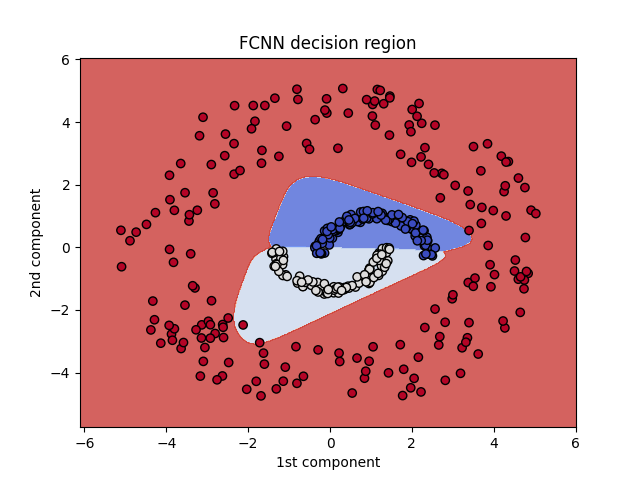

In [210]:
contourplot(X_test.T, y_test.argmax(axis=0), model, lambda x: x.argmax(axis=0), 'FCNN decision region')

In [211]:
confusion_matrix(y_test.argmax(axis=0), predictions.argmax(axis=0))

array([[101.,  12.,   0.],
       [  3.,  95.,   0.],
       [  0.,   2., 187.]])

In [212]:
model = Sequential(
    Input(n_inputs=2),
    Dense(10, activation='sigmoid'),
    Dense(3, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [213]:
model.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [214]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum(predictions.argmax(axis=0) == y_val.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Validation Accuracy = 97.25%


In [215]:
predictions = model(X_test)
print(f'Test Accuracy = {np.sum(predictions.argmax(axis=0) == y_test.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Test Accuracy = 96.25%


<IPython.core.display.Javascript object>


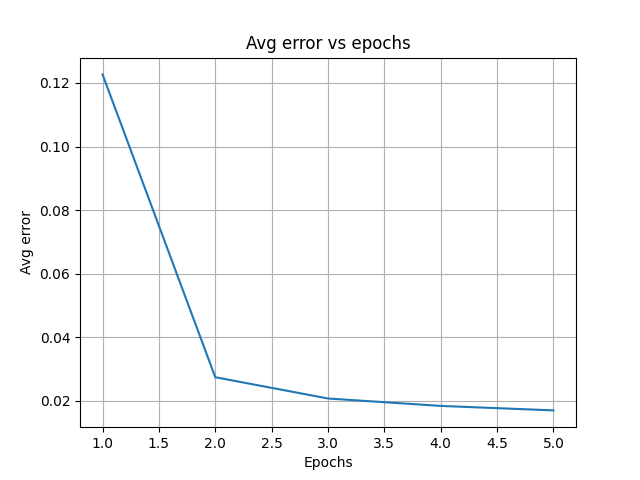

In [216]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


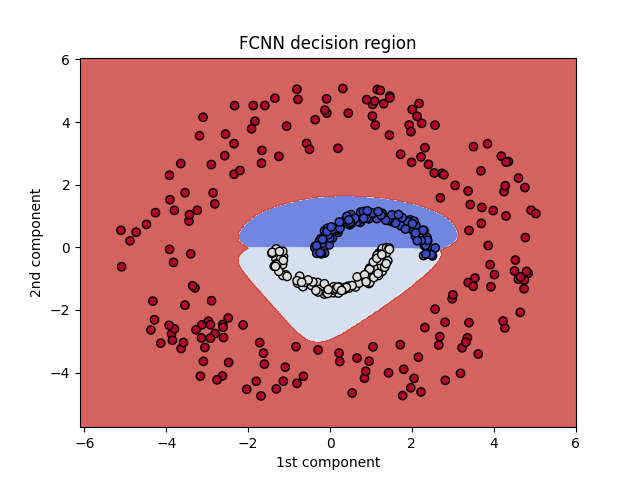

In [217]:
contourplot(X_test.T, y_test.argmax(axis=0), model, lambda x: x.argmax(axis=0), 'FCNN decision region')

In [218]:
confusion_matrix(y_test.argmax(axis=0), predictions.argmax(axis=0))

array([[100.,  13.,   0.],
       [  2.,  96.,   0.],
       [  0.,   0., 189.]])

In [222]:
model = Sequential(
    Input(n_inputs=2),
    Dense(15, activation='sigmoid'),
    Dense(15, activation='sigmoid'),
    Dense(3, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [223]:
model.fit(X_train, y_train, lr=1, batch_size=1, epochs=10)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Epoch 6
-------------------------------
Epoch 7
-------------------------------
Epoch 8
-------------------------------
Epoch 9
-------------------------------
Epoch 10
-------------------------------
Done!


In [224]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum(predictions.argmax(axis=0) == y_val.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Validation Accuracy = 100.0%


In [225]:
predictions = model(X_test)
print(f'Test Accuracy = {np.sum(predictions.argmax(axis=0) == y_test.argmax(axis=0)) * 100 / predictions.shape[-1]}%')

Test Accuracy = 100.0%


<IPython.core.display.Javascript object>


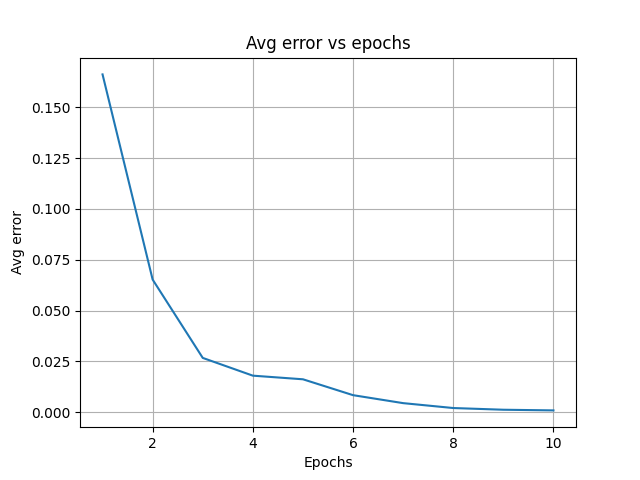

In [226]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


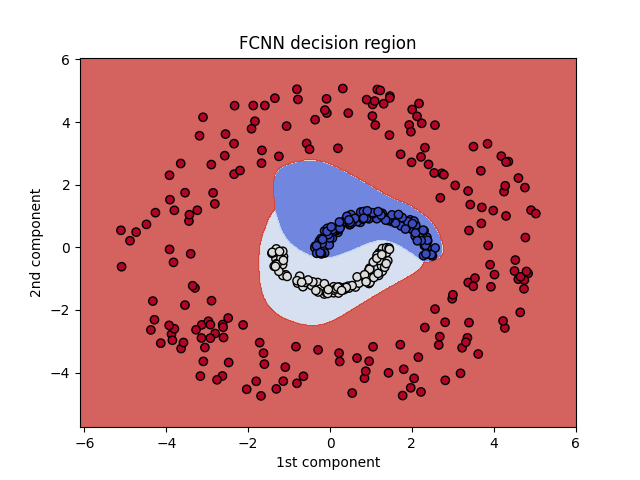

In [227]:
contourplot(X_test.T, y_test.argmax(axis=0), model, lambda x: x.argmax(axis=0), 'FCNN decision region')

In [228]:
confusion_matrix(y_test.argmax(axis=0), predictions.argmax(axis=0))

array([[113.,   0.,   0.],
       [  0.,  98.,   0.],
       [  0.,   0., 189.]])

<IPython.core.display.Javascript object>


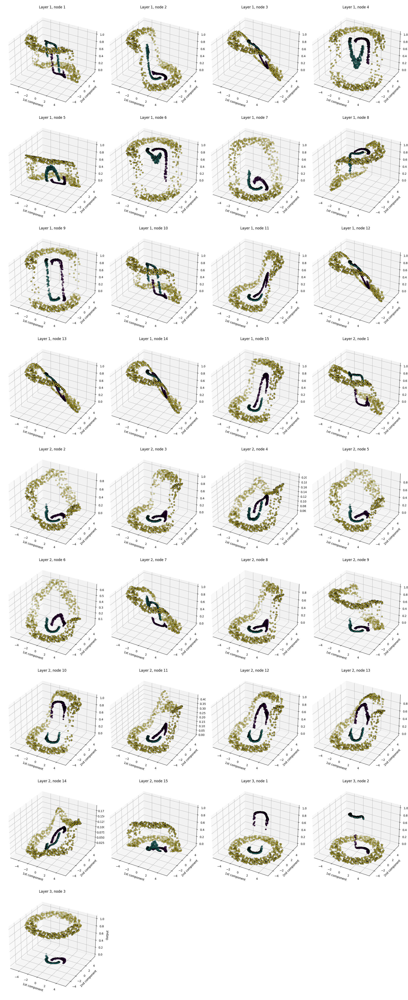

In [229]:
model(X_train)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_train, h, c=y_train.argmax(axis=0), edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


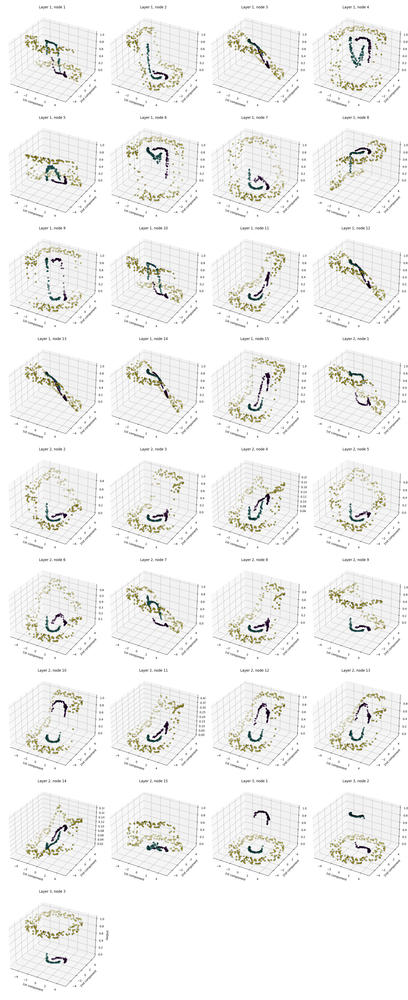

In [230]:
model(X_val)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_val, h, c=y_val.argmax(axis=0), edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


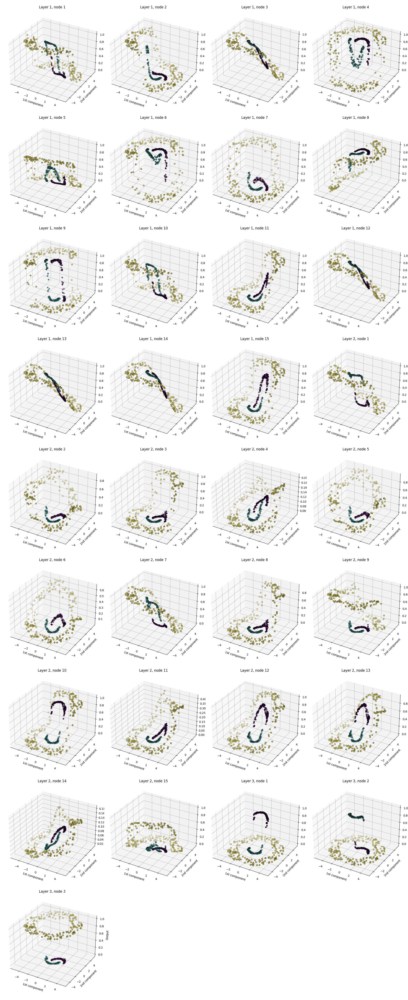

In [231]:
model(X_test)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_test, h, c=y_test.argmax(axis=0), edgecolor='black')
        itr += 1
fig.tight_layout()

# Regression

In [405]:
df_uni = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Regression/UnivariateData/8.csv', header=None)
df_bi = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Regression/BivariateData/8.csv', header=None)

In [406]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(df_uni[0].values, df_uni[1].values)

In [407]:
X_train = X_train.reshape(1, -1)
X_val = X_val.reshape(1, -1)
X_test = X_test.reshape(1, -1)
y_train = y_train.reshape(1, -1)
y_val = y_val.reshape(1, -1)
y_test = y_test.reshape(1, -1)

In [408]:
model = Sequential(
    Input(n_inputs=1),
    Dense(1, activation='linear'),
    loss=MeanSquaredLoss('linear')
)

In [409]:
model.fit(X_train, y_train, batch_size=1, lr=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [410]:
mse = []

Train Accuracy = 61.064891846921796%


<IPython.core.display.Javascript object>


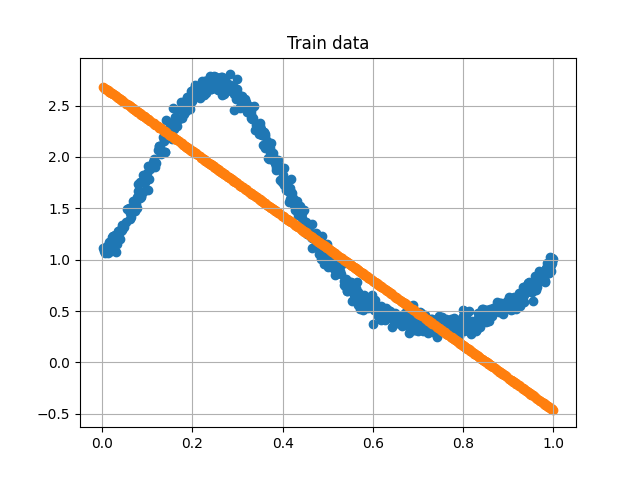

In [411]:
predictions = model(X_train)
mse.append(mean_squared_error(y_train.flatten(), predictions.flatten()))
print(f'Train Accuracy = {np.sum((predictions - y_train) < 1e-3) * 100 / predictions.shape[-1]}%')
X, Y = X_train, y_train
plt.grid(True)
plt.title('Train data')
plt.scatter(X.flatten(), Y.flatten())
plt.scatter(X.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


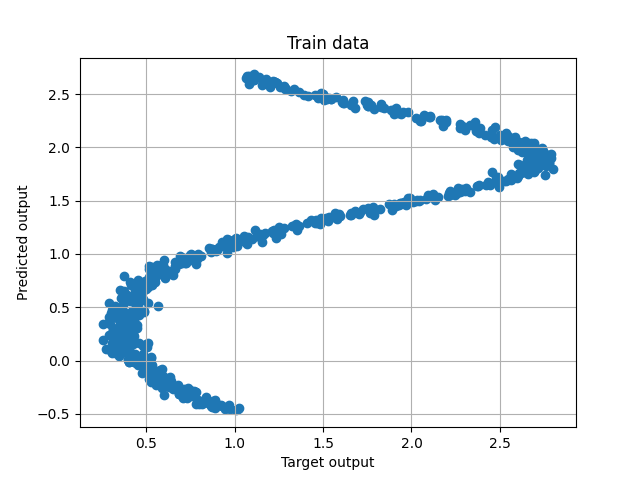

In [412]:
plt.grid(True)
plt.title('Train data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_train.flatten(), predictions.flatten())

Validation Accuracy = 56.5%


<IPython.core.display.Javascript object>


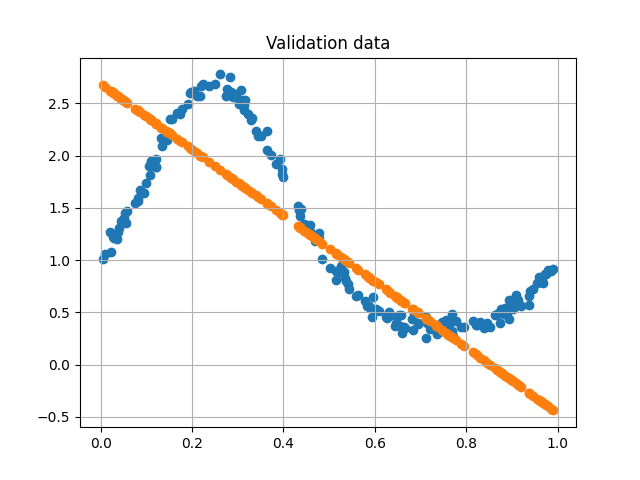

In [413]:
predictions = model(X_val)
mse.append(mean_squared_error(y_val.flatten(), predictions.flatten()))
print(f'Validation Accuracy = {np.sum((predictions - y_val) < 1e-3) * 100 / predictions.shape[-1]}%')
X, Y = X_val, y_val
plt.grid(True)
plt.title('Validation data')
plt.scatter(X.flatten(), Y.flatten())
plt.scatter(X.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


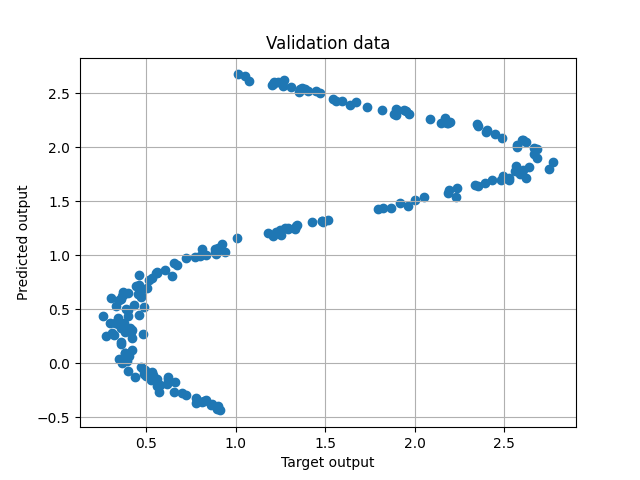

In [414]:
plt.grid(True)
plt.title('Validation data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_val.flatten(), predictions.flatten())

Test Accuracy = 55.0%


<IPython.core.display.Javascript object>


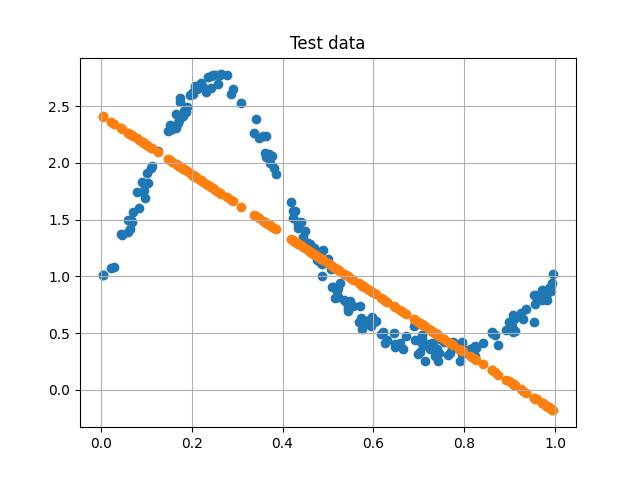

In [257]:
predictions = model(X_test)
mse.append(mean_squared_error(y_test.flatten(), predictions.flatten()))
print(f'Test Accuracy = {np.sum((predictions - y_test) < 1e-3) * 100 / predictions.shape[-1]}%')
X, Y = X_test, y_test
plt.grid(True)
plt.title('Test data')
plt.scatter(X.flatten(), Y.flatten())
plt.scatter(X.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


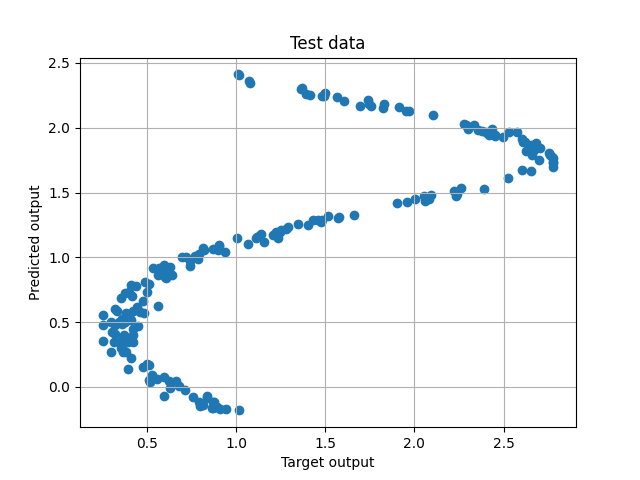

In [258]:
plt.grid(True)
plt.title('Test data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_test.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


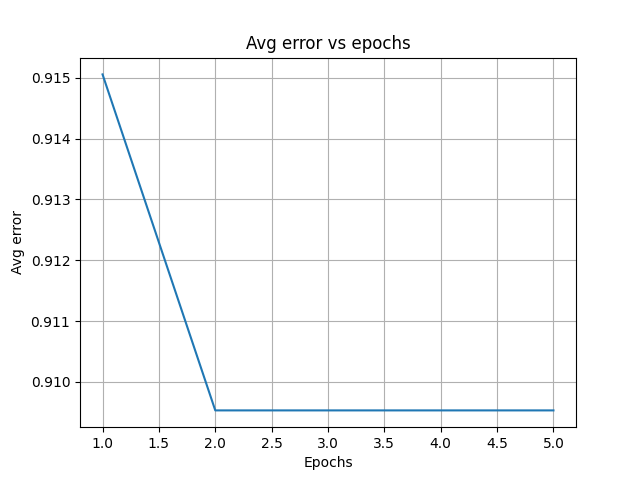

In [259]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


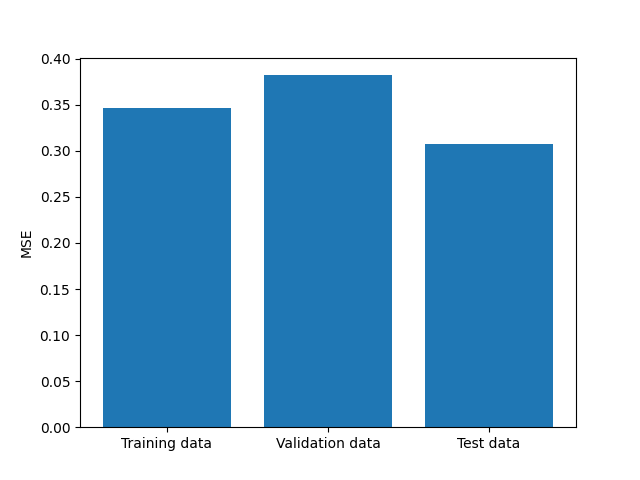

In [260]:
plt.bar(range(len(mse)), mse)
plt.xticks(range(len(mse)), ['Training data', 'Validation data', 'Test data'])
plt.ylabel('MSE')
plt.show()

# FCNN

In [508]:
model = Sequential(
    Input(n_inputs=1),
    Dense(6, activation='sigmoid'),
    Dense(1, activation='linear'),
    loss=MeanSquaredLoss('linear')
)

In [514]:
%%time
model.fit(X_train, y_train, batch_size=32, lr=.1, epochs=1000)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Epoch 6
-------------------------------
Epoch 7
-------------------------------
Epoch 8
-------------------------------
Epoch 9
-------------------------------
Epoch 10
-------------------------------
Epoch 11
-------------------------------
Epoch 12
-------------------------------
Epoch 13
-------------------------------
Epoch 14
-------------------------------
Epoch 15
-------------------------------
Epoch 16
-------------------------------
Epoch 17
-------------------------------
Epoch 18
-------------------------------
Epoch 19
-------------------------------
Epoch 20
-------------------------------
Epoch 21
-------------------------------
Epoch 22
-------------------------------
Epoch 23
-------------------------------
Epoch 24
-------------------------------
Epoch 25
----------------

Train Accuracy = 74.20965058236273%


<IPython.core.display.Javascript object>


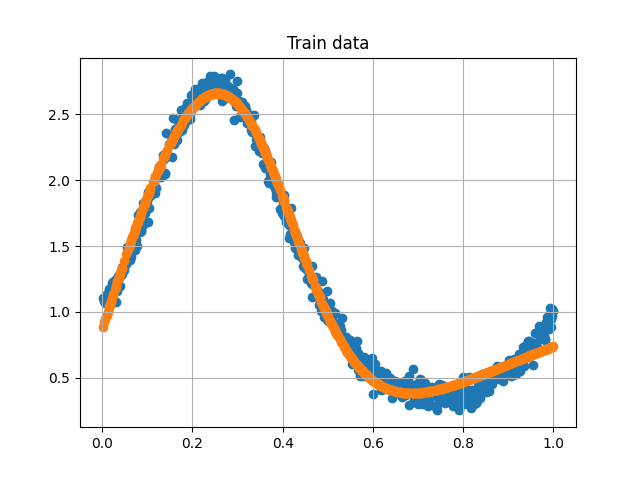

In [515]:
predictions = model(X_train)
print(f'Train Accuracy = {np.sum(np.abs(predictions - y_train) < 1e-1) * 100 / predictions.shape[-1]}%')
X, Y = X_train, y_train
plt.grid(True)
plt.title('Train data')
plt.scatter(X.flatten(), Y.flatten())
plt.scatter(X.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


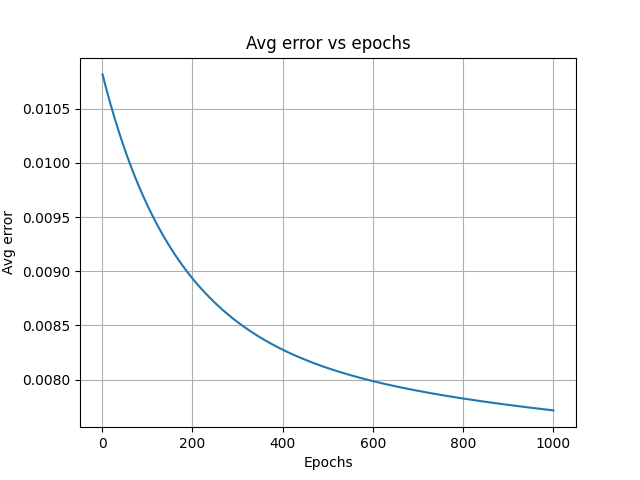

In [516]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

In [517]:
mse = []

Train Accuracy = 74.20965058236273%


<IPython.core.display.Javascript object>


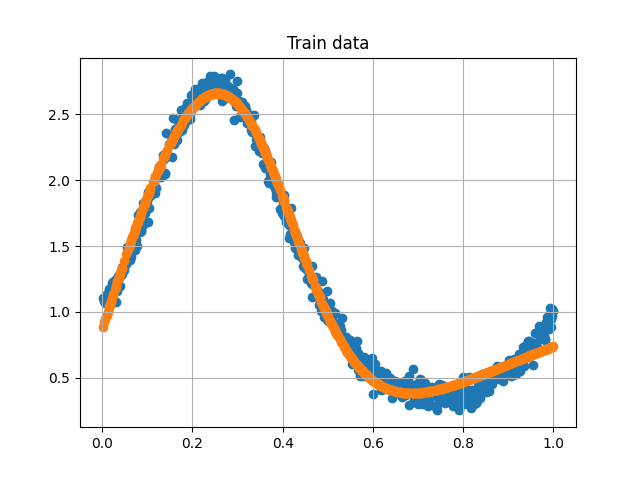

In [518]:
predictions = model(X_train)
mse.append(mean_squared_error(y_train.flatten(), predictions.flatten()))
print(f'Train Accuracy = {np.sum(np.abs(predictions - y_train) < 1e-1) * 100 / predictions.shape[-1]}%')
X, Y = X_train, y_train
plt.grid(True)
plt.title('Train data')
plt.scatter(X.flatten(), Y.flatten())
plt.scatter(X.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


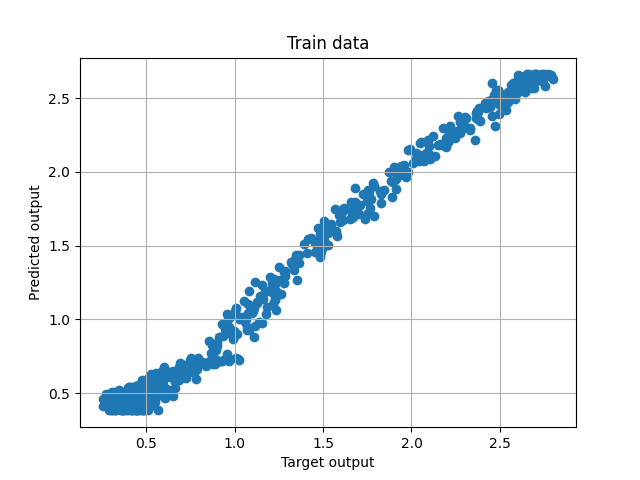

In [519]:
plt.grid(True)
plt.title('Train data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(Y.flatten(), predictions.flatten())

Validation Accuracy = 77.0%


<IPython.core.display.Javascript object>


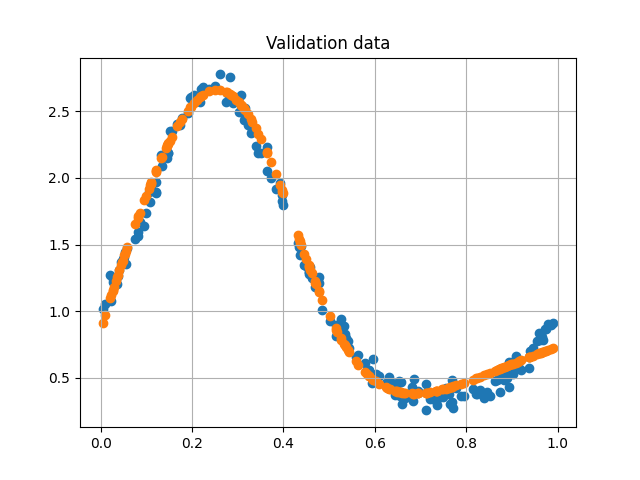

In [520]:
predictions = model(X_val)
mse.append(mean_squared_error(y_val.flatten(), predictions.flatten()))
print(f'Validation Accuracy = {np.sum(np.abs(predictions - y_val) < 1e-1) * 100 / predictions.shape[-1]}%')
X, Y = X_val, y_val
plt.grid(True)
plt.title('Validation data')
plt.scatter(X.flatten(), Y.flatten())
plt.scatter(X.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


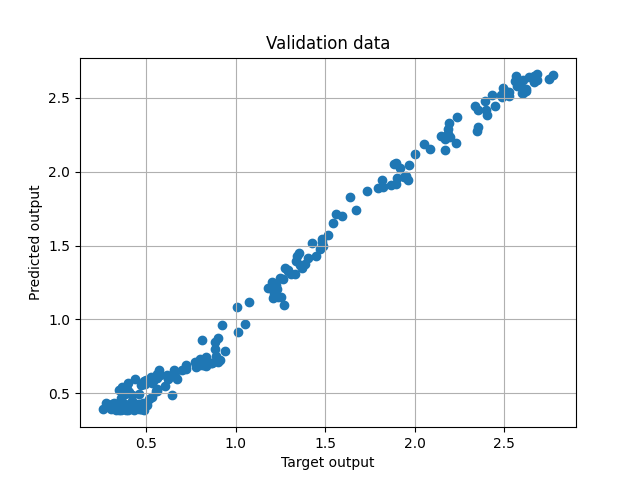

In [521]:
plt.grid(True)
plt.title('Validation data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(Y.flatten(), predictions.flatten())

Test Accuracy = 79.5%


<IPython.core.display.Javascript object>


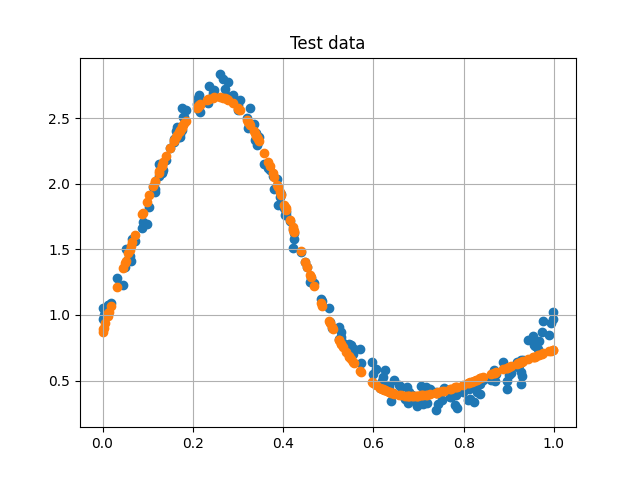

In [522]:
predictions = model(X_test)
mse.append(mean_squared_error(y_test.flatten(), predictions.flatten()))
print(f'Test Accuracy = {np.sum(np.abs(predictions - y_test) < 1e-1) * 100 / predictions.shape[-1]}%')
X, Y = X_test, y_test
plt.grid(True)
plt.title('Test data')
plt.scatter(X.flatten(), Y.flatten())
plt.scatter(X.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


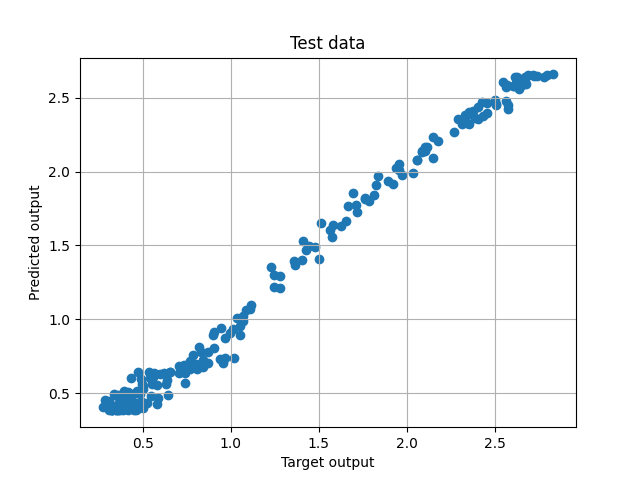

In [523]:
plt.grid(True)
plt.title('Test data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(Y.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


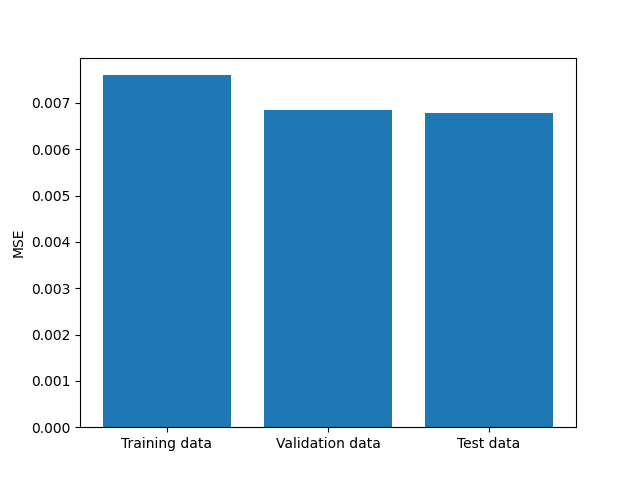

In [524]:
plt.bar(range(len(mse)), mse)
plt.xticks(range(len(mse)), ['Training data', 'Validation data', 'Test data'])
plt.ylabel('MSE')
plt.show()

<IPython.core.display.Javascript object>


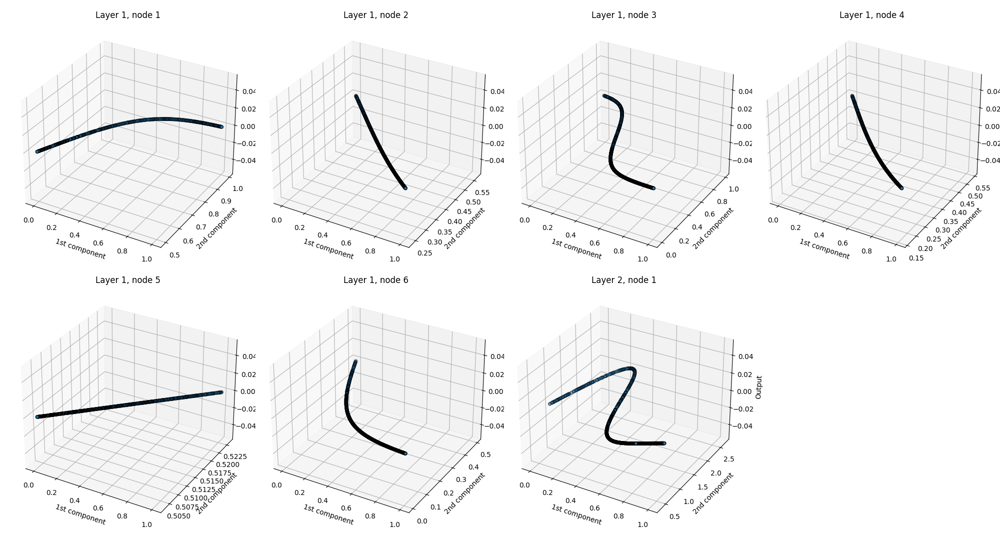

In [525]:
model(X_train)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_train, h, edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


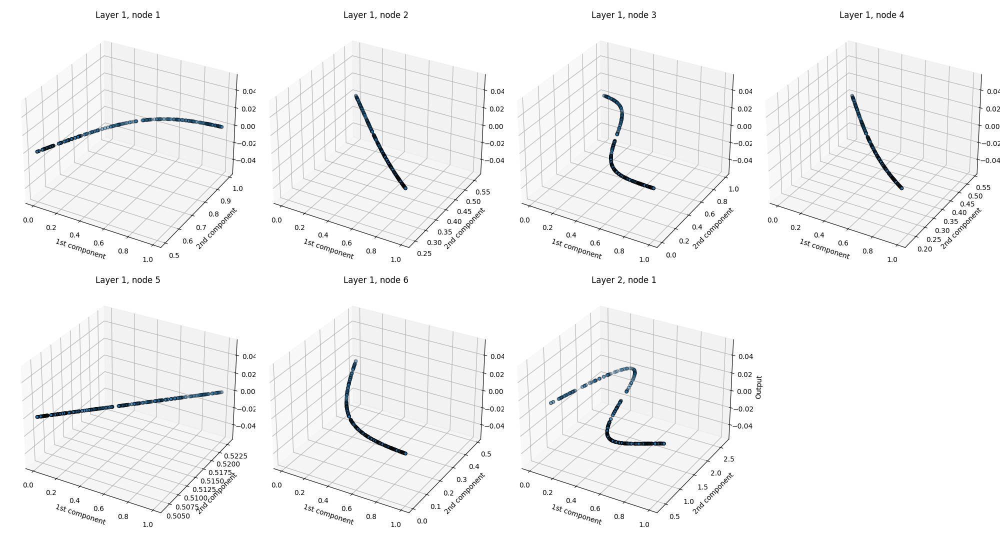

In [526]:
model(X_val)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_val, h,  edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


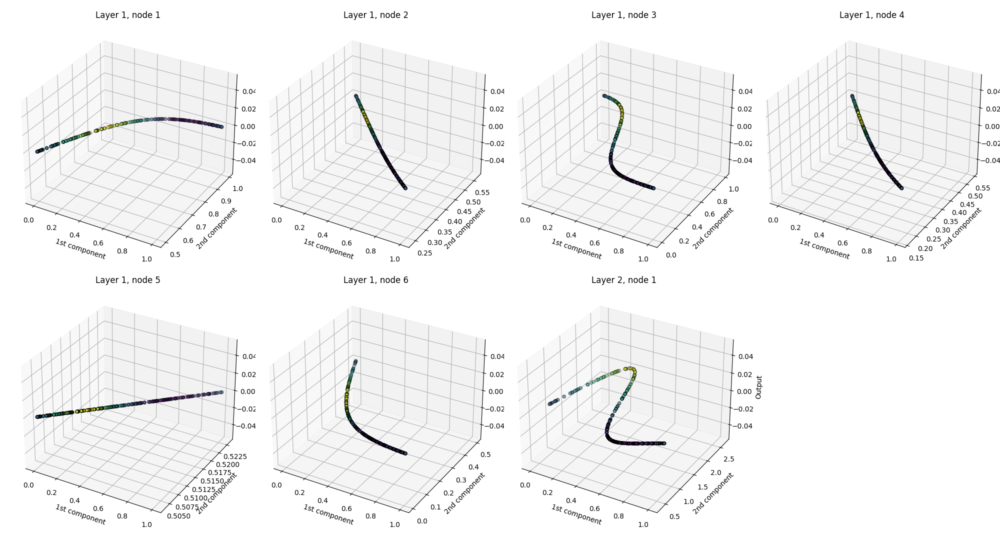

In [527]:
model(X_test)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(22 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_test, h, c=y_test.flatten(), edgecolor='black')
        itr += 1
fig.tight_layout()

# Bi-Variate

In [341]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(df_bi[[0, 1]].values, df_bi[2].values)

In [342]:
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1, -1)
y_val = y_val.reshape(1, -1)
y_test = y_test.reshape(1, -1)

In [343]:
model = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='linear'),
    loss=MeanSquaredLoss('linear')
)

In [344]:
model.fit(X_train, y_train, batch_size=1, lr=.05, epochs=20)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Epoch 6
-------------------------------
Epoch 7
-------------------------------
Epoch 8
-------------------------------
Epoch 9
-------------------------------
Epoch 10
-------------------------------
Epoch 11
-------------------------------
Epoch 12
-------------------------------
Epoch 13
-------------------------------
Epoch 14
-------------------------------
Epoch 15
-------------------------------
Epoch 16
-------------------------------
Epoch 17
-------------------------------
Epoch 18
-------------------------------
Epoch 19
-------------------------------
Epoch 20
-------------------------------
Done!


In [345]:
mse = []

Validation Accuracy = 81.42460382290476%


<IPython.core.display.Javascript object>


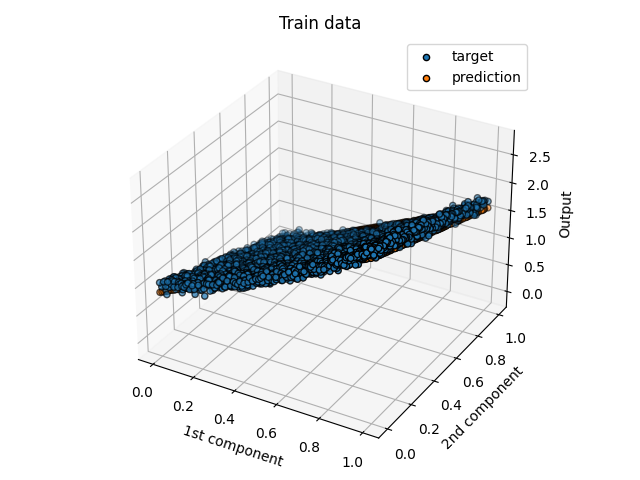

In [346]:
predictions = model(X_train)
print(f'Train Accuracy = {np.sum((predictions.flatten() - y_train.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_train.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Train data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_train, y_train.flatten(), edgecolor='black', label='target')
ax.scatter(*X_train, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


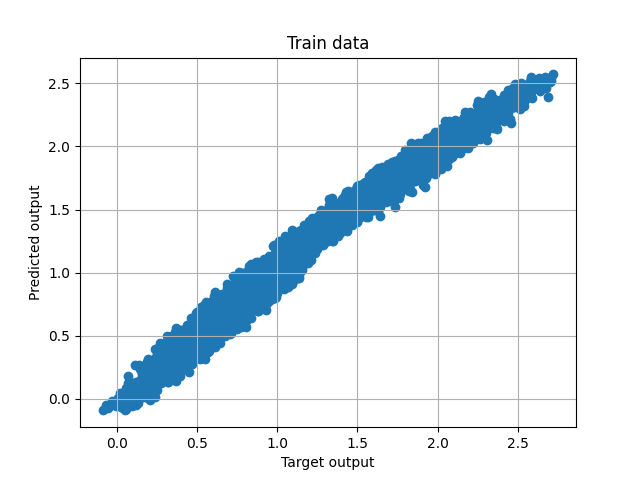

In [347]:
plt.grid(True)
plt.title('Train data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_train.flatten(), predictions.flatten())

Validation Accuracy = 82.00980392156863%


<IPython.core.display.Javascript object>


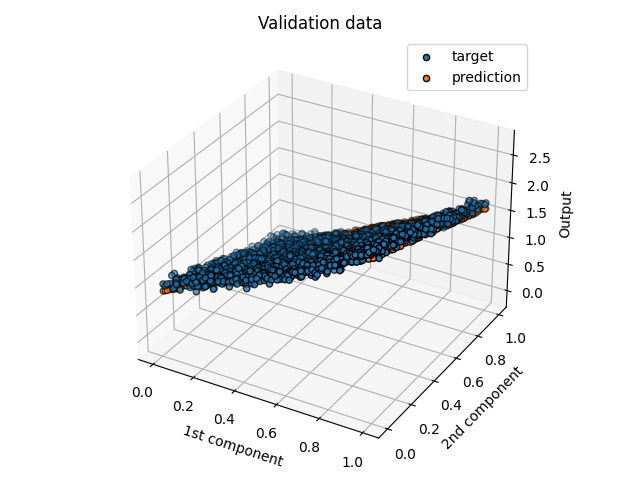

In [348]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_val.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_val.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Validation data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_val, y_val.flatten(), edgecolor='black', label='target')
ax.scatter(*X_val, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


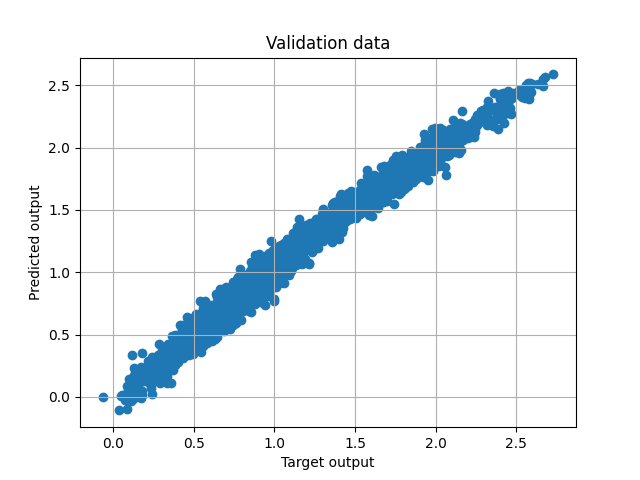

In [349]:
plt.grid(True)
plt.title('Validation data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_val.flatten(), predictions.flatten())

Validation Accuracy = 80.53921568627452%


<IPython.core.display.Javascript object>


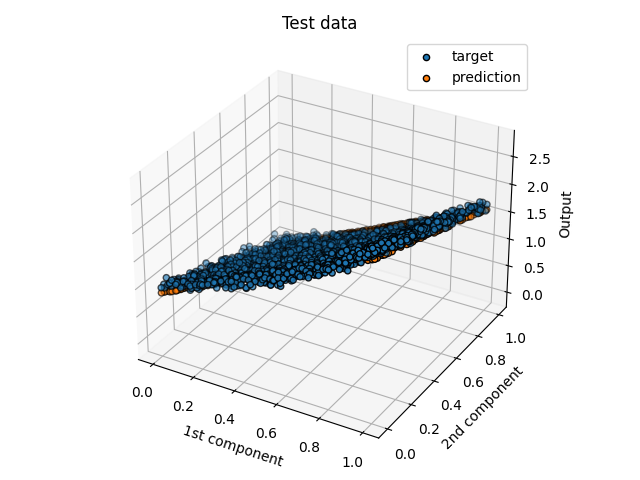

In [350]:
predictions = model(X_test)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_test.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_test.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Test data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_test, y_test.flatten(), edgecolor='black', label='target')
ax.scatter(*X_test, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


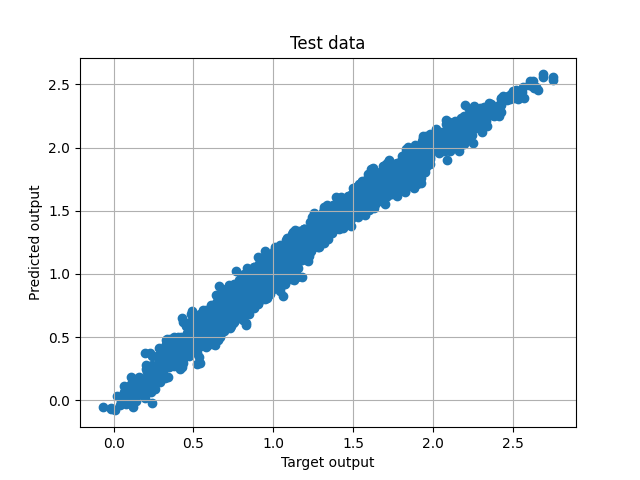

In [352]:
plt.grid(True)
plt.title('Test data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_test.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


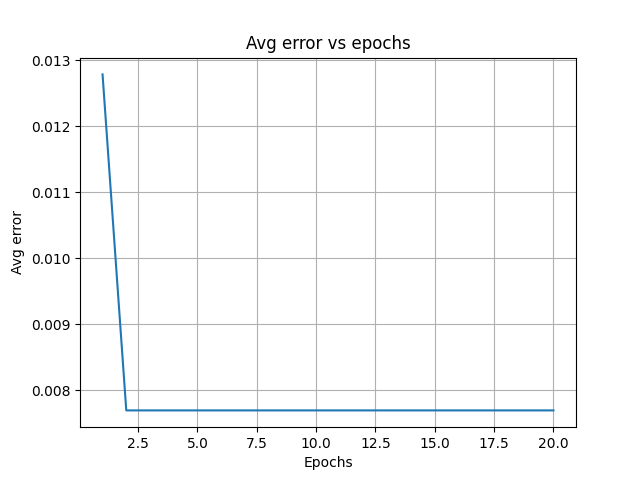

In [353]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


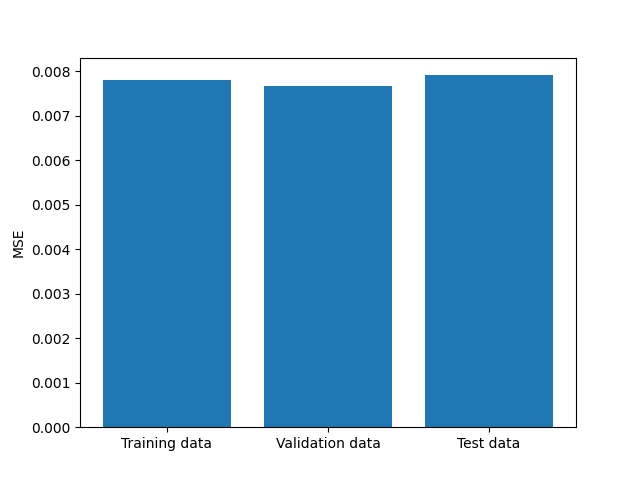

In [354]:
plt.bar(range(len(mse)), mse)
plt.xticks(range(len(mse)), ['Training data', 'Validation data', 'Test data'])
plt.ylabel('MSE')
plt.show()

# FCNN

In [359]:
model = Sequential(
    Input(n_inputs=2),
    Dense(3, activation='sigmoid'),
    Dense(1, activation='linear'),
    loss=MeanSquaredLoss('linear')
)

In [360]:
%%time
model.fit(X_train, y_train, batch_size=1, lr=.05, epochs=20)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Epoch 6
-------------------------------
Epoch 7
-------------------------------
Epoch 8
-------------------------------
Epoch 9
-------------------------------
Epoch 10
-------------------------------
Epoch 11
-------------------------------
Epoch 12
-------------------------------
Epoch 13
-------------------------------
Epoch 14
-------------------------------
Epoch 15
-------------------------------
Epoch 16
-------------------------------
Epoch 17
-------------------------------
Epoch 18
-------------------------------
Epoch 19
-------------------------------
Epoch 20
-------------------------------
Done!
CPU times: user 13.8 s, sys: 0 ns, total: 13.8 s
Wall time: 13.8 s


In [361]:
mse = []

Validation Accuracy = 92.19081849371018%


<IPython.core.display.Javascript object>


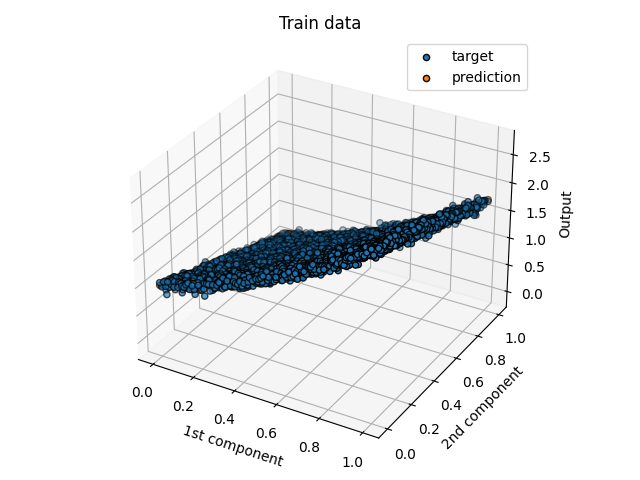

In [362]:
predictions = model(X_train)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_train.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_train.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Train data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_train, y_train.flatten(), edgecolor='black', label='target')
ax.scatter(*X_train, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


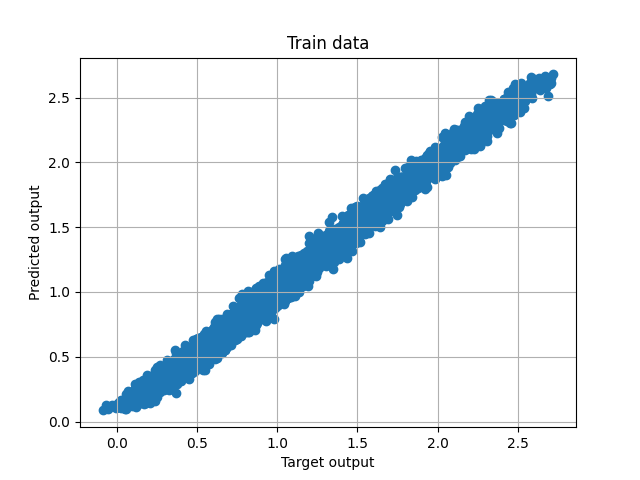

In [363]:
plt.grid(True)
plt.title('Train data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_train.flatten(), predictions.flatten())

Validation Accuracy = 91.51960784313725%


<IPython.core.display.Javascript object>


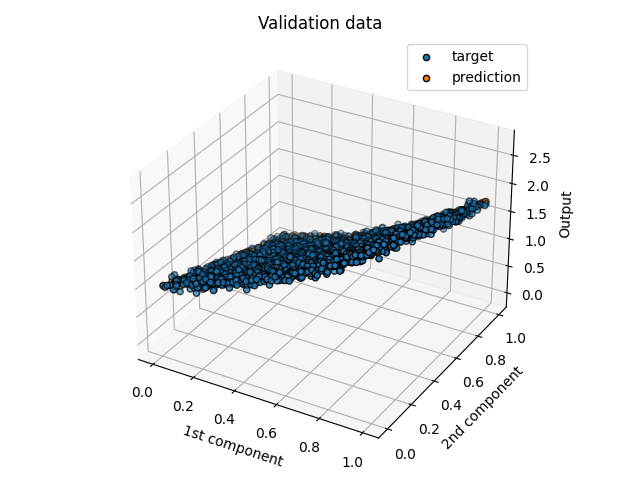

In [364]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_val.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_val.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Validation data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_val, y_val.flatten(), edgecolor='black', label='target')
ax.scatter(*X_val, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


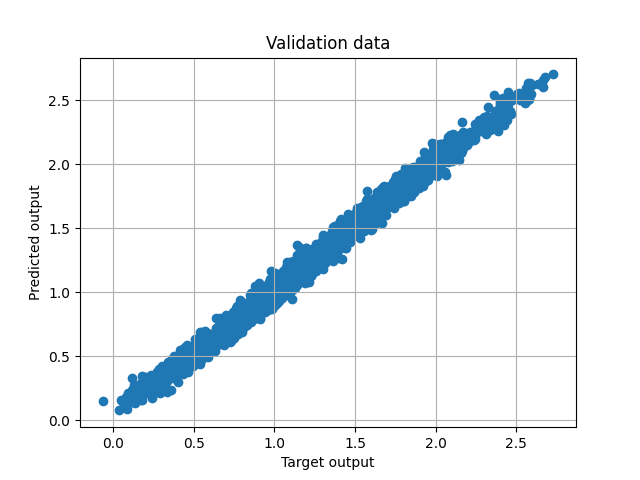

In [365]:
plt.grid(True)
plt.title('Validation data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_val.flatten(), predictions.flatten())

Validation Accuracy = 90.88235294117646%


<IPython.core.display.Javascript object>


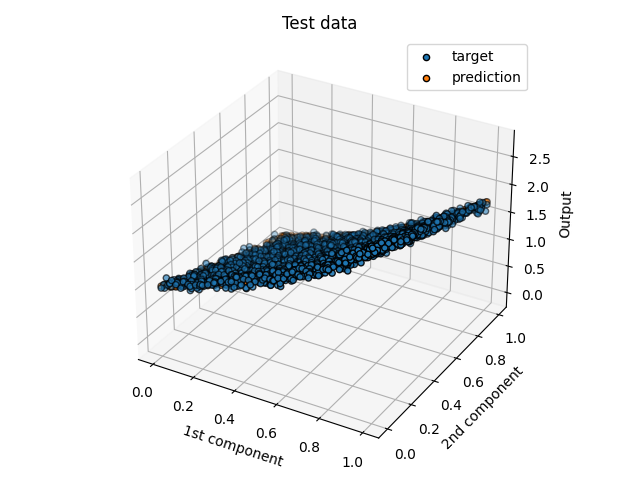

In [366]:
predictions = model(X_test)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_test.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_test.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Test data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_test, y_test.flatten(), edgecolor='black', label='target')
ax.scatter(*X_test, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


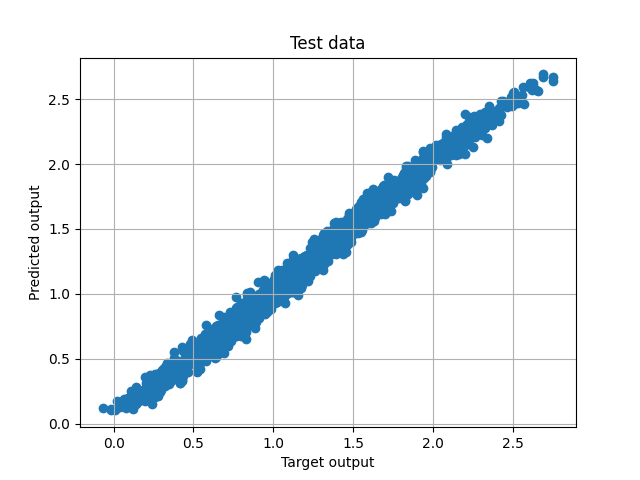

In [367]:
plt.grid(True)
plt.title('Test data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_test.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


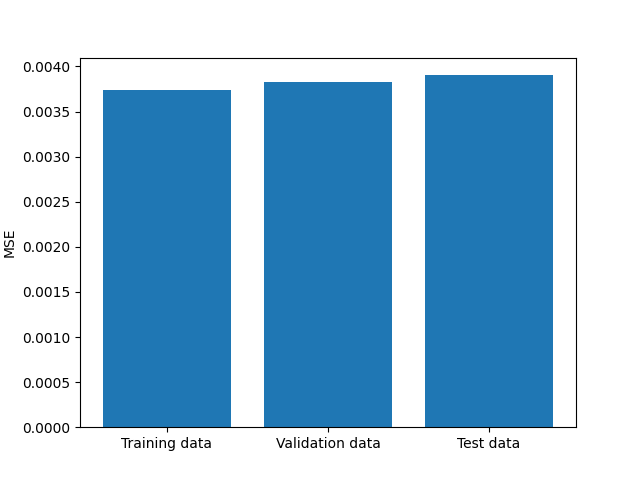

In [368]:
plt.bar(range(len(mse)), mse)
plt.xticks(range(len(mse)), ['Training data', 'Validation data', 'Test data'])
plt.ylabel('MSE')
plt.show()

<IPython.core.display.Javascript object>


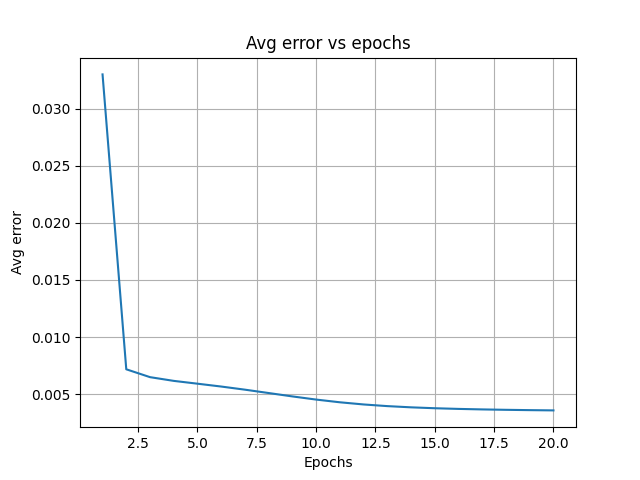

In [369]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


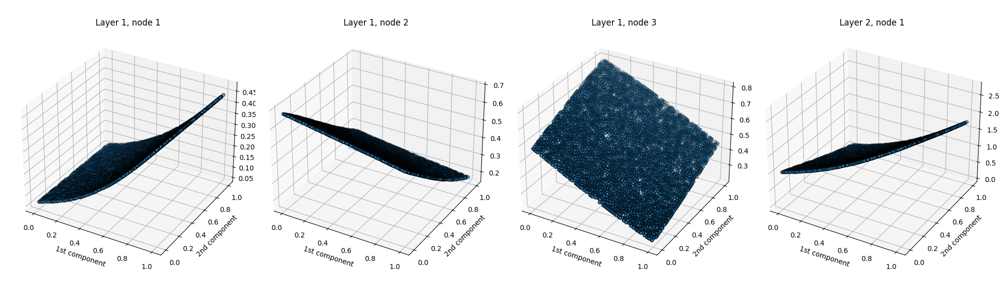

In [370]:
model(X_train)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(25 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_train, h, edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


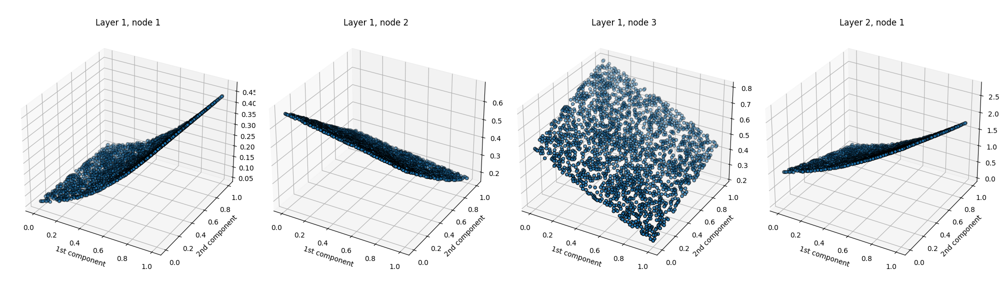

In [371]:
model(X_val)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(25 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_val, h, edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


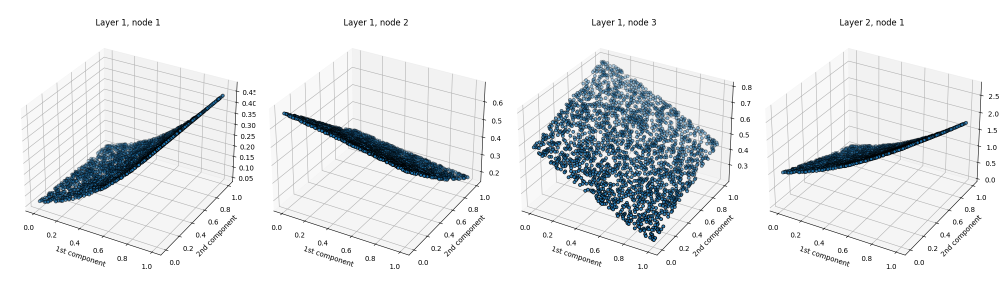

In [372]:
model(X_test)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(25 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_test, h, edgecolor='black')
        itr += 1
fig.tight_layout()

In [373]:
model = Sequential(
    Input(n_inputs=2),
    Dense(3, activation='sigmoid'),
    Dense(4, activation='sigmoid'),
    Dense(1, activation='linear'),
    loss=MeanSquaredLoss('linear')
)

In [374]:
%%time
model.fit(X_train, y_train, batch_size=1, lr=.05, epochs=300)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Epoch 6
-------------------------------
Epoch 7
-------------------------------
Epoch 8
-------------------------------
Epoch 9
-------------------------------
Epoch 10
-------------------------------
Epoch 11
-------------------------------
Epoch 12
-------------------------------
Epoch 13
-------------------------------
Epoch 14
-------------------------------
Epoch 15
-------------------------------
Epoch 16
-------------------------------
Epoch 17
-------------------------------
Epoch 18
-------------------------------
Epoch 19
-------------------------------
Epoch 20
-------------------------------
Epoch 21
-------------------------------
Epoch 22
-------------------------------
Epoch 23
-------------------------------
Epoch 24
-------------------------------
Epoch 25
----------------

In [375]:
mse = []

Validation Accuracy = 92.14180689429831%


<IPython.core.display.Javascript object>


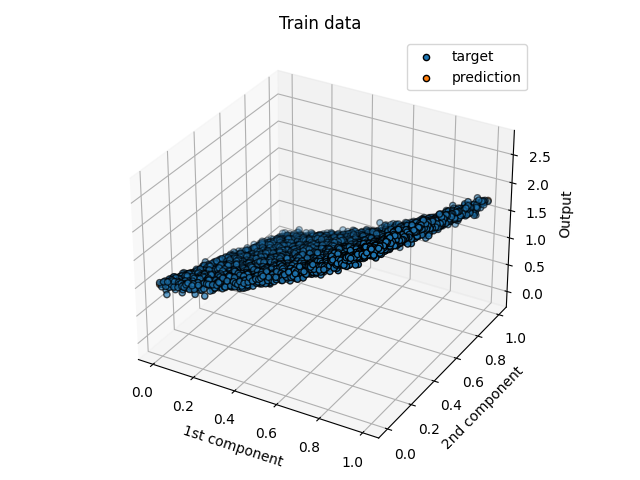

In [376]:
predictions = model(X_train)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_train.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_train.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Train data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_train, y_train.flatten(), edgecolor='black', label='target')
ax.scatter(*X_train, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


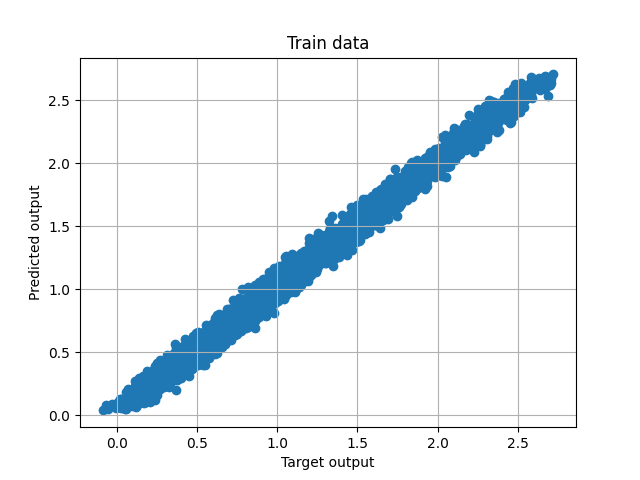

In [377]:
plt.grid(True)
plt.title('Train data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_train.flatten(), predictions.flatten())

Validation Accuracy = 91.32352941176471%


<IPython.core.display.Javascript object>


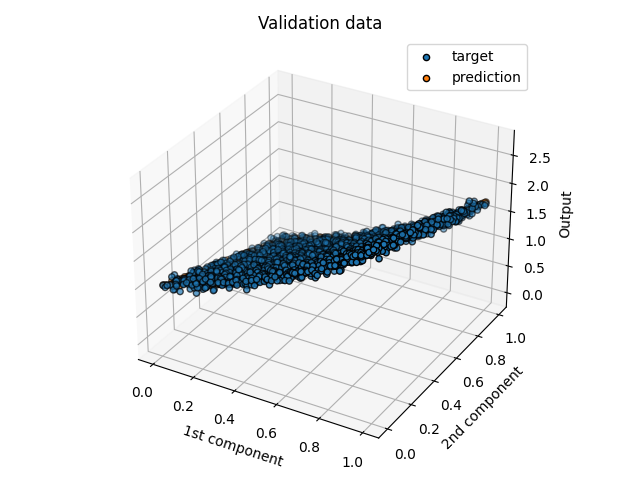

In [378]:
predictions = model(X_val)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_val.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_val.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Validation data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_val, y_val.flatten(), edgecolor='black', label='target')
ax.scatter(*X_val, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


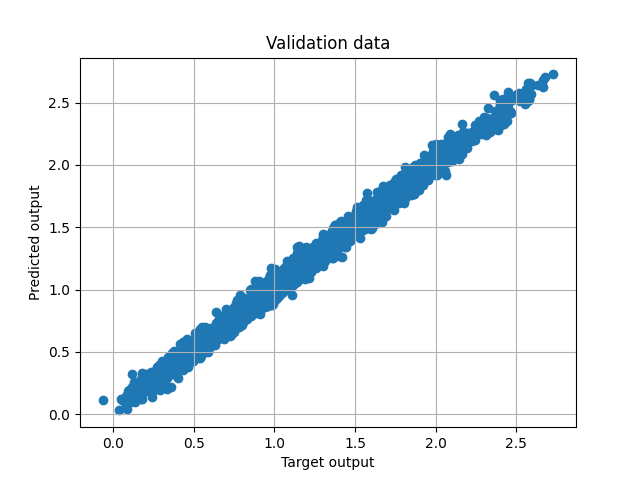

In [379]:
plt.grid(True)
plt.title('Validation data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_val.flatten(), predictions.flatten())

Validation Accuracy = 90.7843137254902%


<IPython.core.display.Javascript object>


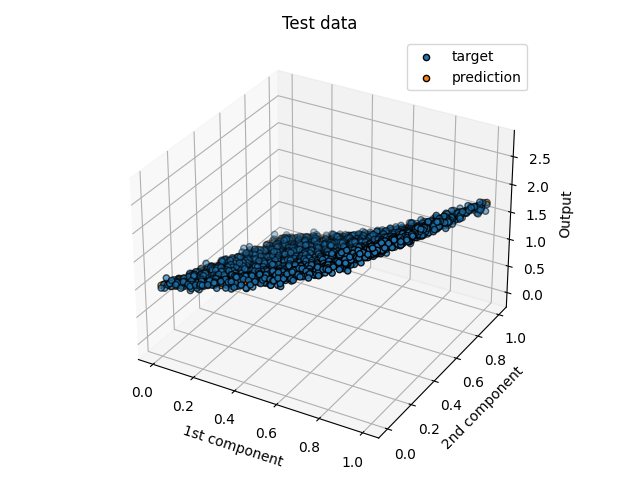

In [380]:
predictions = model(X_test)
print(f'Validation Accuracy = {np.sum((predictions.flatten() - y_test.flatten()) < 1e-1) * 100 / predictions.shape[-1]}%')
mse.append(mean_squared_error(y_test.flatten(), predictions.flatten()))
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title(f'Test data')
ax.set_xlabel('1st component')
ax.set_ylabel('2nd component')
ax.set_zlabel('Output')
ax.scatter(*X_test, y_test.flatten(), edgecolor='black', label='target')
ax.scatter(*X_test, predictions.flatten(), edgecolor='black', label='prediction')
fig.tight_layout()
plt.legend()

<IPython.core.display.Javascript object>


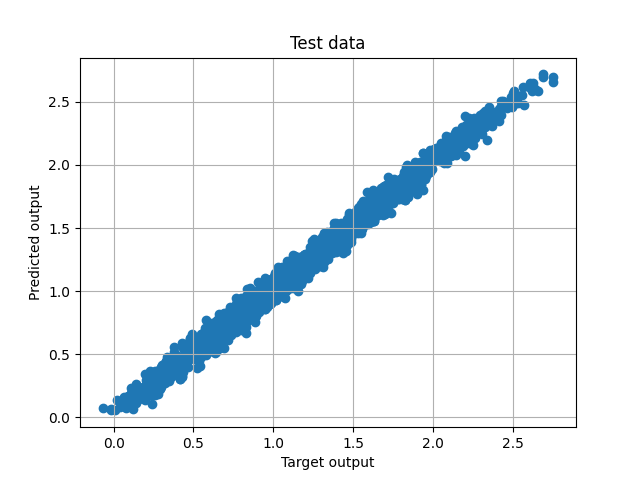

In [381]:
plt.grid(True)
plt.title('Test data')
plt.xlabel('Target output')
plt.ylabel('Predicted output')
plt.scatter(y_test.flatten(), predictions.flatten())

<IPython.core.display.Javascript object>


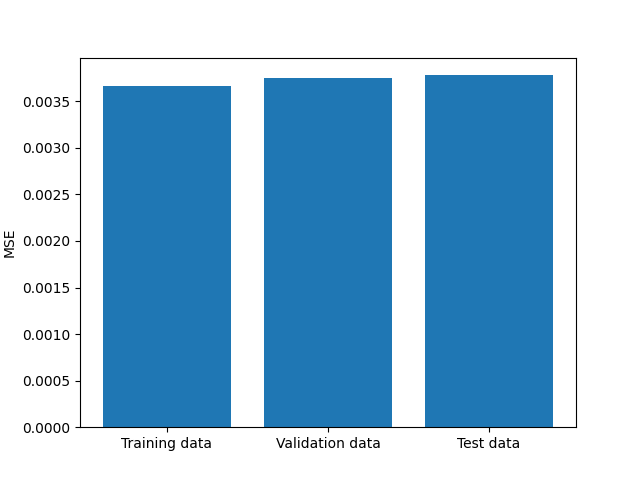

In [383]:
plt.bar(range(len(mse)), mse)
plt.xticks(range(len(mse)), ['Training data', 'Validation data', 'Test data'])
plt.ylabel('MSE')
plt.show()

<IPython.core.display.Javascript object>


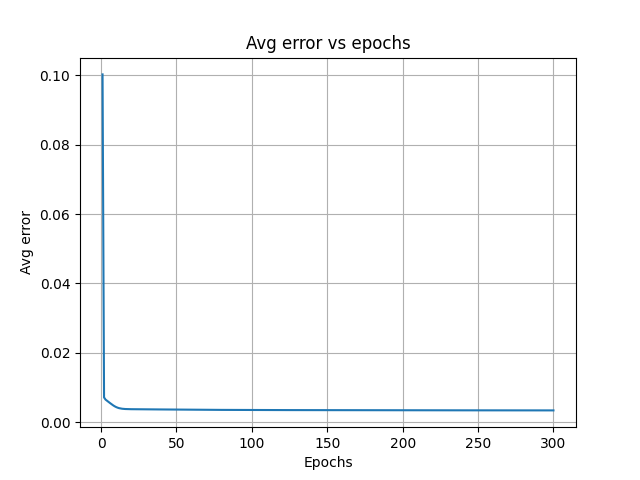

In [384]:
plt.grid(True)
plt.title('Avg error vs epochs')
plt.xlabel('Epochs')
plt.ylabel('Avg error')
plt.plot(range(1, len(model.losses)+1), model.losses)

<IPython.core.display.Javascript object>


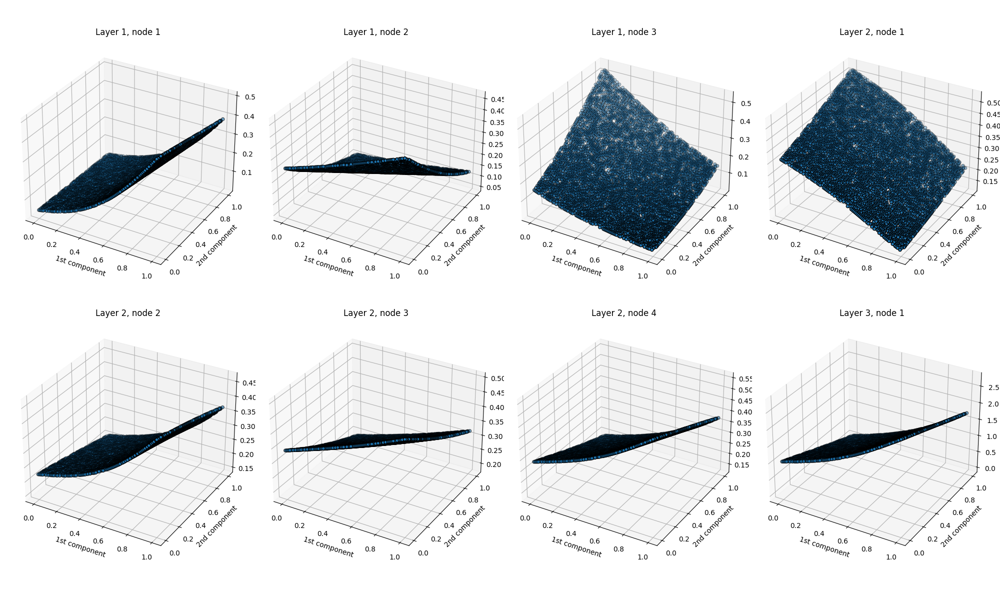

In [385]:
model(X_train)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(25 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_train, h, edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


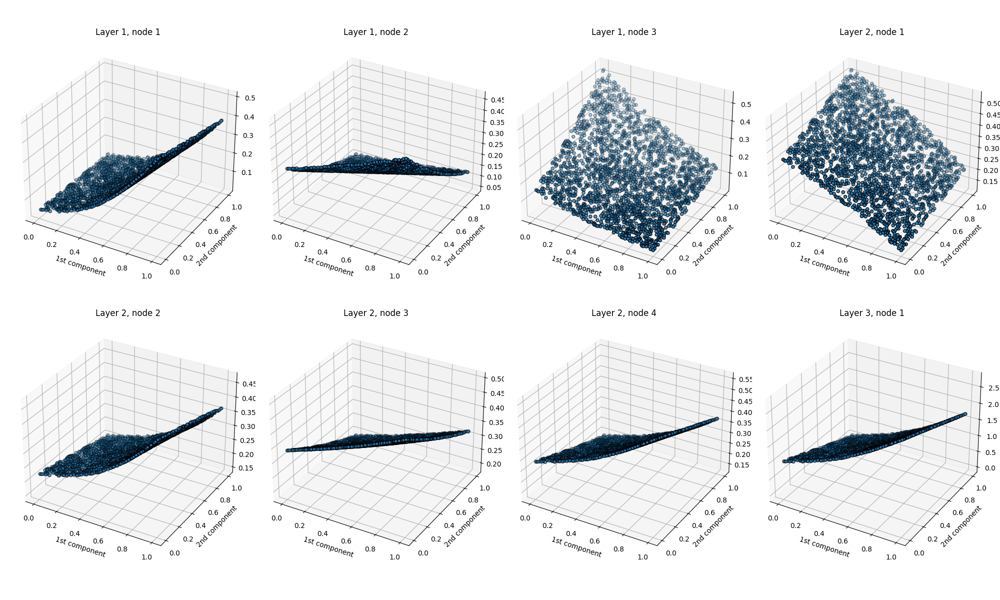

In [386]:
model(X_val)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(25 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_val, h, edgecolor='black')
        itr += 1
fig.tight_layout()

<IPython.core.display.Javascript object>


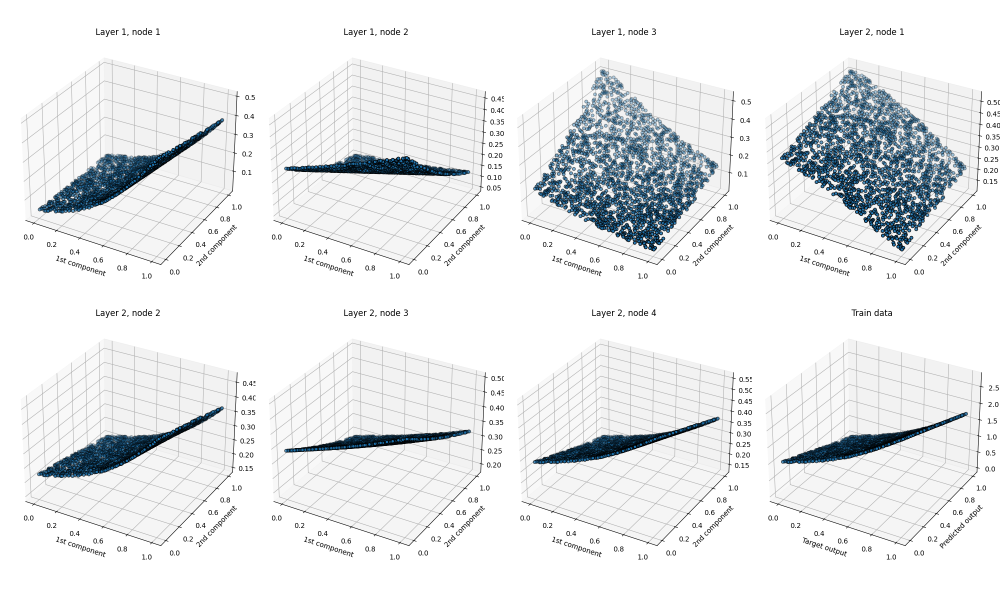

In [387]:
model(X_test)
n = np.sum(list(layer.H.shape[0] for layer in model.layers[1:]))
c = 4
r = int(np.ceil(n / c))
fig = plt.figure(figsize=(20, int(25 * r / c)))
itr = 1
for l, layer in enumerate(model.layers[1:]):
    for n, h in enumerate(layer.H):
        ax = fig.add_subplot(r, c, itr, projection='3d')
        ax.set_title(f'Layer {l+1}, node {n+1}')
        ax.set_xlabel('1st component')
        ax.set_ylabel('2nd component')
        ax.set_zlabel('Output')
        ax.scatter(*X_test, h, edgecolor='black')
        itr += 1
fig.tight_layout()

In [264]:
df1 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Regression/UnivariateData/8.csv', header=None)
df2 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Regression/BivariateData/8.csv', header=None)

In [265]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(df1[0].values, df1[1].values)

In [223]:
y_train = E(y_train, 3)
y_val = E(y_val, 3)
y_test = E(y_test, 3)

In [347]:
model = Sequential([
    Input(input_shape=2),
    Dense(5, activation='sigmoid'),
    Dense(1, activation='softmax'),
])

In [348]:
model.compile(loss=CrossEntropyLoss())

In [252]:
model.fit(X_train, y_train, batch_size=1, lr=1)

Epoch: 1, 1200/1200 | Accuracy: 77.25%, loss: 0.019
Epoch: 2, 1068/1200 | Accuracy: 95.60%, loss: 0.004Epoch: 2, 1200/1200 | Accuracy: 95.50%, loss: 0.006
Epoch: 3, 1200/1200 | Accuracy: 96.25%, loss: 0.003
Epoch: 4, 1200/1200 | Accuracy: 96.08%, loss: 0.002
Epoch: 5, 1200/1200 | Accuracy: 96.33%, loss: 0.002


In [253]:
model.evaluate(X_val, y_val)

In [254]:
model.evaluate(X_val, y_val)

In [332]:
df1 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Regression/UnivariateData/8.csv', header=None)
df2 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Regression/BivariateData/8.csv', header=None)

In [261]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(df1[0].values, df1[1].values)

In [298]:
model = Sequential([
    Input(input_shape=1),
    Dense(1, activation='sigmoid'),
])

In [299]:
model.compile(loss=MeanSquaredLoss('linear'))

In [301]:
model.fit(X_train.reshape(-1, 1), y_train.reshape(-1, 1), batch_size=1, lr=1, epochs=1)

Epoch: 1, 601/601 | Accuracy: 100.00%, loss: 0.468


In [302]:
model.evaluate(X_val.reshape(-1,1), y_val.reshape(-1,1))

In [303]:
model.evaluate(X_test.reshape(-1,1), y_test.reshape(-1,1))

In [340]:
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(df2[[0, 1]].values, df2[1].values)

In [343]:
model = Sequential([
    Input(input_shape=2),
    Dense(4, activation='sigmoid'),
    Dense(1, activation='softmax')
])

In [344]:
model.compile(loss=CrossEntropyLoss())

In [ ]:
y_test

In [346]:
model.fit(X_train, y_train.reshape(-1, 1), batch_size=1, lr=1, epochs=1)

Epoch: 1, 6121/6121 | Accuracy: 100.00%, loss: 0.000


In [319]:
model.evaluate(X_val.reshape(-1,1), y_val.reshape(-1,1))

In [320]:
model.evaluate(X_test.reshape(-1,1), y_test.reshape(-1,1))

In [269]:
df1 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Classification/LS_Group08/Class1.txt', sep=' ', header=None)
df2 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Classification/LS_Group08/Class2.txt', sep=' ', header=None)
df3 = pd.read_csv('/home/akash/Desktop/Documents/sem6/cs671/assignment_1/Group08/Classification/LS_Group08/Class3.txt', sep=' ', header=None)
df1['class'] = 0
df2['class'] = 1
df3['class'] = 2

In [270]:
data = pd.concat((df1, df2, df3))
label = data.pop('class')

In [271]:
data_0_1 = data[(label == 0) | (label == 1)]
label_0_1 = label[(label == 0) | (label == 1)] == 1
X_train, X_val, X_test, y_train, y_val, y_test = train_test_split(data_0_1.values, label_0_1.values)
X_train = X_train.T
X_val = X_val.T
X_test = X_test.T
y_train = y_train.reshape(1,-11)
y_val = y_val.reshape(1,-1)
y_test = y_test.reshape(1,-1)

In [289]:
model = Sequential(
    Input(n_inputs=2),
    Dense(1, activation='sigmoid'),
    loss=MeanSquaredLoss('sigmoid')
)

In [290]:
model.fit(X_train, y_train, lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [291]:
predictions = model(X_val)
print(f'Validation accuracy = {np.sum((predictions > 0.5) == y_val) * 100 / predictions.shape[1]}%')

Validation accuracy = 51.0%


In [275]:
predictions = model(X_test)
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_test) * 100 / predictions.shape[1]}%')

Test accuracy = 100.0%


(2, 304)

In [330]:
model.fit(X_train[:, y_train.flatten()==1], y_train[:, y_train.flatten()==1], lr=1, batch_size=1, epochs=5)

Epoch 1
-------------------------------
Epoch 2
-------------------------------
Epoch 3
-------------------------------
Epoch 4
-------------------------------
Epoch 5
-------------------------------
Done!


In [ ]:
self.loss.grad(Y, self.layers[-1].H, self.layers[-1].A)

In [347]:
sigmoid(model.layers[-1].A)

array([[8.13213228e-10]])

In [346]:
model.layers[-1].A

array([[-20.93002777]])

In [345]:
model.loss.activation

'sigmoid'

In [339]:
model.layers[-1].grad_L_A

array([[-8.13213226e-10]])

In [338]:
model.layers[-1].grad_L_A @ model.layers[0].H.T

array([[-7.00550666e-09, -8.08919460e-09]])

In [334]:
print(model.layers[-1].grad_L_W)
print(model.layers[-1].grad_L_B)

[[-7.00550666e-09 -8.08919460e-09]]
[-8.13213226e-10]


In [349]:
model.layers[0].H

array([[8.6146],
       [9.9472]])

In [355]:
X_train[1].min()

-10.718

In [348]:
model.layers[-1].W @ model.layers[0].H

array([[-20.86133003]])

In [331]:
print(model.layers[-1].W)
print(model.layers[-1].B)

[[-1.47400621 -0.82066874]]
[-0.06869759]


In [332]:
model.losses

[0.9999996560757096,
 0.9999996549741933,
 0.9999996538655319,
 0.9999996527496522,
 0.9999996516264844]

In [356]:
predictions = model(X_train[:, y_train.flatten()==1])
print(f'Test accuracy = {np.sum((predictions > 0.5) == y_train[:, y_train.flatten()==1]) * 100 / predictions.shape[1]}%')

Test accuracy = 0.0%


<IPython.core.display.Javascript object>


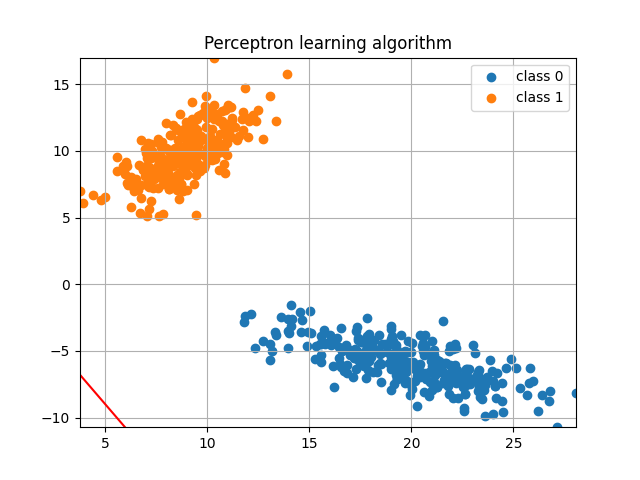

In [313]:
samples = X_train.T
labels = y_train.flatten()
w1, w2 = model.layers[-1].W.flatten()
b, = model.layers[-1].B

plt.scatter(*samples[labels==0].T, label='class 0')
plt.scatter(*samples[labels==1].T, label='class 1')
plt.xlim(samples.T[0].min(), samples.T[0].max())
plt.ylim(samples.T[1].min(), samples.T[1].max())
plt.grid(True)
plt.title(f'Perceptron learning algorithm')
plt.legend()
plt.plot([-100,100], (w1 * np.array([-100,100]) + b) / -w2, c='r')